In [1]:
from utilities_ketamine_analysis_v8 import *

In [2]:
# whos

In [3]:
# You may need to uncomment the following line if running this
# notebook on Colab

import ghostipy as gsp
import numpy as np
import scipy.signal as signal
import matplotlib.pyplot as plt
import matplotlib.ticker as plticker
import os
import h5py
import warnings
from urllib.request import urlopen
plt.rcParams['pdf.fonttype'] = 42

In [4]:
from scipy.signal import butter, lfilter, freqz, iirnotch, welch 

# Filenames to analyze

In [5]:
binPath = r'G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\electrophysiology\\'
binFullPath = Path(binPath)

In [6]:
#nt_Path for behavior
#sync_path for sync pulse
#ksort_path

dlc_path = binFullPath.parents[1]

files = dlc_path.glob('**/*.mat')

sync_path=[]
nt_path=[]

for i in sorted(files):
    
    if 'sync' in str(i): 
        print(i)
        sync_path.append(i)
        
    if 'behavior' in str(i): 
        print(i)
        nt_path.append(i)

print(nt_path[-1])

In [11]:
sync_path

[WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/sync/2022-07-27_07-41-00_M015_SAL_PFC_HPC_0_0_0mpk.mat'),
 WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/sync/2022-07-28_13-19-00_M016_SAL_PFC_HPC_0_0_0mpk.mat'),
 WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/sync/2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk.mat'),
 WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/sync/2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk.mat'),
 WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/sync/2022-08-04_03-45-00_M016_RSK_mPFC_HPC_3_10_30mpk.mat'),
 WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/sync/2022-08-06-05-20-00_M016_RSK_mPFC_HPC_3_10_30mpk.mat'),
 WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/N

In [12]:

#Example of how to append two files together
dlc_path = binFullPath
ksort_HPC_path=[]
ksort_PFC_path=[]

files = os.listdir(dlc_path)
for i in sorted(files):
            
    if 'HPCprobe' in str(i): 
        ksort_HPC_path.append(Path(r'G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\electrophysiology\\' + i))
        print(i)
#     if 'PFCprobe' in str(i): 
#         ksort_PFC_path.append(Path(r'G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\electrophysiology\\' + i))      
#         print(i)
        
print(ksort_HPC_path)

2022-07-27_07-41-00_M015_SAL_PFC_HPC_0_0_0mpk_HPCprobe
2022-07-28_13-19-00_M016_SAL_PFC_HPC_0_0_0mpk_HPCprobe
2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk_HPCprobe
2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk_HPCprobe
2022-08-04_03-45-00_M016_RSK_mPFC_HPC_3_10_30mpk_HPCprobe
2022-08-06-05-20-00_M016_RSK_mPFC_HPC_3_10_30mpk_HPCprobe
2022-08-08-04-05-00_M017_SAL_mPFC_HPC_0_0_0mpk_HPCprobe
2022-08-11-01-55-00_M018_SAL_mPFC_HPC_0_0_0mpk_HPCprobe
2022-08-12-02-35-00_M017_RSK_mPFC_HPC_3_10_30mpk_HPCprobe
2022-08-13-03-57-00_M018_RSK_mPFC_HPC_3_10_30mpk_HPCprobe
2022-08-15-02-25-00_M018_RSK_mPFC_HPC_3_10_30mpk_HPCprobe
2022-08-18-01-20-00_M020_1020_mPFC_HPC_1_3_10_30mpk_HPCprobe
2022-08-19-04-25-00_M019_1020_mPFC_HPC_1_3_10_30mpk_HPCprobe
2022-09-06-01-50-00-M021_1020_mPFC_HPC_1_3_10_30mpk_HPCprobe
2022-09-07-02-54-00-M022_1020_mPFC_HPC_1_3_10_30mpk_HPCprobe
2022-09-12-04-40-00_M023_SAL_mPFC_HPC_0_0_0mpk_HPCprobe
2022-09-14-03-35-00_M023_RSK_mPFC_HPC_3_10_30mpk_HPCprobe
2022-09-16-02-

# Behavior

### Load neurotar

In [13]:
print(len(nt_path),len(sync_path),len(ksort_HPC_path))

36 36 36


In [14]:
import mat73
ts_ephys_aln = []
nt_sync_aln = []
camera_sync_aln = []
ioFS = []
x = []
y = []
yaw = []
speed = []
sync_bool = []

for ipath in range(0,len(nt_path)):
    
    ipathsync = sync_path[ipath]
    ipathnt = nt_path[ipath]

    print('experiment',ipathsync)
    
    # raw files for sync and behavior
    sync_extracted = mat73.loadmat(ipathsync)
    behavior = loadmat(ipathnt)
    
    if np.abs(sync_extracted['samplesSyncAP_HPCprobe'].size - sync_extracted['samplesCamera'].size) < 1000:
        
        ts_ephys_aln.append(sync_extracted['samplesSyncAP_HPCprobe'])
        nt_sync_aln.append(sync_extracted['samplesNeurotarStrobe'])
        camera_sync_aln.append(sync_extracted['samplesCamera'])
        ioFS.append(sync_extracted['ioFS'])
        
        x.append(behavior['nt_x'][0])
        y.append(behavior['nt_y'][0])
        yaw.append(behavior['nt_alpha'][0])
        speed.append(behavior['nt_speed'][0])
        
        
        sync_bool.append(True)
        
    else:
        sync_bool.append(False)


#     if 'SAL' in ipathsync:

experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\sync\2022-07-27_07-41-00_M015_SAL_PFC_HPC_0_0_0mpk.mat
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\sync\2022-07-28_13-19-00_M016_SAL_PFC_HPC_0_0_0mpk.mat
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\sync\2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk.mat
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\sync\2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk.mat
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\sync\2022-08-04_03-45-00_M016_RSK_mPFC_HPC_3_10_30mpk.mat
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\sync\2022-08-06-05-20-00_M016_RSK_mPFC_HPC_3_10_30mpk.mat
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\sync\2022-08-0

In [15]:
ipath

35

In [16]:
print(sync_bool)
sync_cond = (np.hstack(sync_bool))
print(sync_cond)

[True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True]
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True]


In [17]:
idx_sync_ok = np.flatnonzero(sync_cond == True)
idx_sync_ok.shape

(36,)

In [18]:
#Already alligned
sync_path_matched = np.array(sync_path)[idx_sync_ok]
nt_path_matched = np.array(nt_path)[idx_sync_ok]
ksort_HPC_path_matched = np.array(ksort_HPC_path)[idx_sync_ok]
# ksort_PFC_path_matched = np.array(ksort_PFC_path)[idx_sync_ok]

In [19]:
print(ksort_HPC_path_matched)

[WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/electrophysiology/2022-07-27_07-41-00_M015_SAL_PFC_HPC_0_0_0mpk_HPCprobe')
 WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/electrophysiology/2022-07-28_13-19-00_M016_SAL_PFC_HPC_0_0_0mpk_HPCprobe')
 WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/electrophysiology/2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk_HPCprobe')
 WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/electrophysiology/2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk_HPCprobe')
 WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/electrophysiology/2022-08-04_03-45-00_M016_RSK_mPFC_HPC_3_10_30mpk_HPCprobe')
 WindowsPath('G:/My Drive/Fenton_Lab/Ketamine_analysis/Ketamine_data/Neurotar_HPC_ketamine/SPK/electrophysiology/2022-08-06-05-20-00_M016_RSK

In [20]:
%whos ndarray & list & DataFrame

Variable                 Type       Data/Info
---------------------------------------------
camera_sync_aln          list       n=36
files                    list       n=73
idx_sync_ok              ndarray    36: 36 elems, type `int64`, 288 bytes
ioFS                     list       n=36
ksort_HPC_path           list       n=36
ksort_HPC_path_matched   ndarray    36: 36 elems, type `object`, 288 bytes
ksort_PFC_path           list       n=0
nt_path                  list       n=36
nt_path_matched          ndarray    36: 36 elems, type `object`, 288 bytes
nt_sync_aln              list       n=36
speed                    list       n=36
sync_bool                list       n=36
sync_cond                ndarray    36: 36 elems, type `bool`, 36 bytes
sync_path                list       n=36
sync_path_matched        ndarray    36: 36 elems, type `object`, 288 bytes
ts_ephys_aln             list       n=36
x                        list       n=36
y                        list       n=36
yaw  

experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\sync\2022-07-27_07-41-00_M015_SAL_PFC_HPC_0_0_0mpk.mat


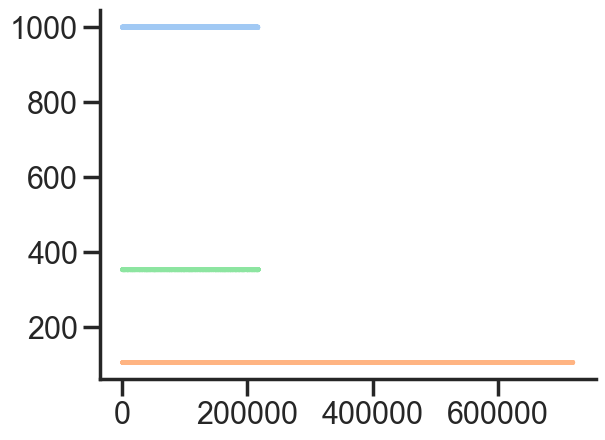

[3.0000000e+02 6.5300000e+02 1.0060000e+03 ... 7.6862194e+07 7.6862546e+07
 7.6862899e+07]
[  101676.   101782.   101888. ... 76393290. 76393396. 76393502.]
camera [288] [216384]
[216096]
217115 720220 217715
nt [3] [720217]
[7202.000933333334] [7201.89834239 7201.89834239 7201.89834239 7201.89834239 7201.89834239
 7201.89834239 7201.89834239 7201.89834239 7201.89834239 7201.89834239
 7201.89834239 7201.89834239 7201.89834239 7201.89834239 7201.89834239
 7201.89834239 7201.89834239 7201.89834239 7201.89834239 7201.89834239
 7201.89834239 7201.89834239 7201.89834239 7201.89834239 7201.89834239
 7201.89834239 7201.89834239 7201.89834239 7201.89834239 7201.89834239
 7201.89834239 7201.89834239 7201.89834239 7201.89834239 7201.89834239
 7201.89834239]
Deviation of [102.59094486] in miliseconds
Deviation at start [-1.0384] in miliseconds
Deviation at end [7.1744] in miliseconds
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\sync\2022-07-28_13-19-

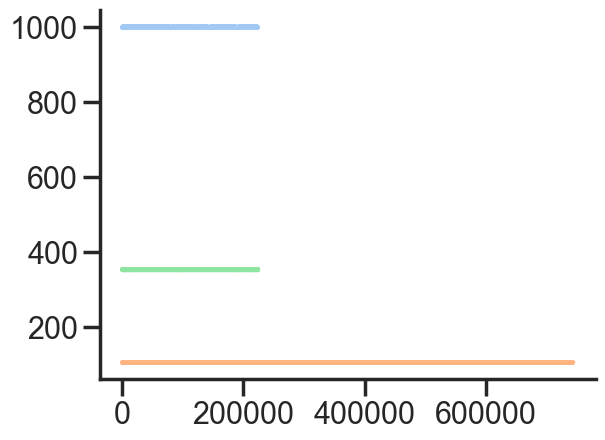

[2.7900000e+02 6.3100000e+02 9.8400000e+02 ... 7.9087070e+07 7.9087423e+07
 7.9087777e+07]
[  237589.   237695.   237801. ... 78991297. 78991403. 78991509.]
camera [673] [223415]
[222742]
223416 743463 224016
nt [3] [742370]
[7202.000933333334, 7423.529366666667] [7423.42030879 7423.42030879 7423.42030879 7423.42030879 7423.42030879
 7423.42030879 7423.42030879 7423.42030879 7423.42030879 7423.42030879
 7423.42030879 7423.42030879 7423.42030879 7423.42030879 7423.42030879
 7423.42030879 7423.42030879 7423.42030879 7423.42030879 7423.42030879
 7423.42030879 7423.42030879 7423.42030879 7423.42030879 7423.42030879
 7423.42030879 7423.42030879 7423.42030879 7423.42030879 7423.42030879
 7423.42030879 7423.42030879 7423.42030879 7423.42030879 7423.42030879
 7423.42030879]
Deviation of [109.05787854] in miliseconds
Deviation at start [-1.416] in miliseconds
Deviation at end [8.6848] in miliseconds
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\sync

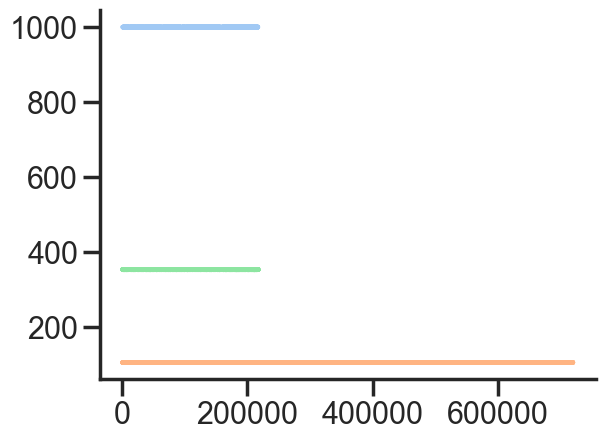

[  134206.   134560.   134913. ... 77070277. 77070630. 77070983.]
[  370933.   371039.   371145. ... 76664109. 76664215. 76664321.]
camera [671] [216743]
[216072]
217296 720235 217896
nt [2] [720232]
[7202.000933333334, 7423.529366666667, 7202.1657] [7202.05580159 7202.05580159 7202.05580159 7202.05580159 7202.05580159
 7202.05580159 7202.05580159 7202.05580159 7202.05580159 7202.05580159
 7202.05580159 7202.05580159 7202.05580159 7202.05580159 7202.05580159
 7202.05580159 7202.05580159 7202.05580159 7202.05580159 7202.05580159
 7202.05580159 7202.05580159 7202.05580159 7202.05580159 7202.05580159
 7202.05580159 7202.05580159 7202.05580159 7202.05580159 7202.05580159
 7202.05580159 7202.05580159 7202.05580159 7202.05580159 7202.05580159
 7202.05580159]
Deviation of [109.89841152] in miliseconds
Deviation at start [-0.6608] in miliseconds
Deviation at end [9.44] in miliseconds
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\sync\2022-08-03_12-

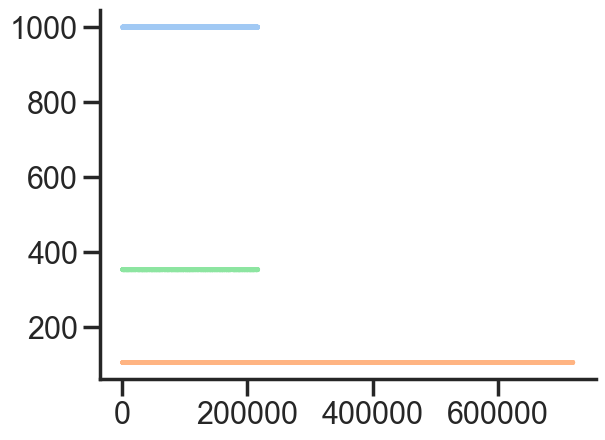

[4.8546000e+04 4.8899000e+04 4.9252000e+04 ... 7.6621546e+07 7.6621899e+07
 7.6622252e+07]
[  264092.   264198.   264304. ... 76542276. 76542382. 76542488.]
camera [611] [216675]
[216064]
216902 720095 216902
nt [2] [720093]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666] [7200.65056319 7200.65056319 7200.65056319 7200.65056319 7200.65056319
 7200.65056319 7200.65056319 7200.65056319 7200.65056319 7200.65056319
 7200.65056319 7200.65056319 7200.65056319 7200.65056319 7200.65056319
 7200.65056319 7200.65056319 7200.65056319 7200.65056319 7200.65056319
 7200.65056319 7200.65056319 7200.65056319 7200.65056319 7200.65056319
 7200.65056319 7200.65056319 7200.65056319 7200.65056319 7200.65056319
 7200.65056319 7200.65056319 7200.65056319 7200.65056319 7200.65056319
 7200.65056319]
Deviation of [121.00347819] in miliseconds
Deviation at start [-2.2656] in miliseconds
Deviation at end [6.5136] in miliseconds
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data

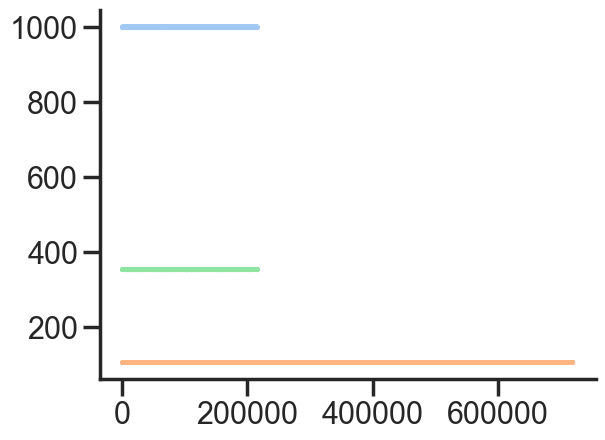

[  146910.   147263.   147615. ... 76618898. 76619251. 76619604.]
[  247968.   248074.   248180. ... 76560257. 76560363. 76560469.]
camera [287] [216414]
[216127]
216583 720417 216583
nt [3] [720414]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667] [7203.85006239 7203.85006239 7203.85006239 7203.85006239 7203.85006239
 7203.85006239 7203.85006239 7203.85006239 7203.85006239 7203.85006239
 7203.85006239 7203.85006239 7203.85006239 7203.85006239 7203.85006239
 7203.85006239 7203.85006239 7203.85006239 7203.85006239 7203.85006239
 7203.85006239 7203.85006239 7203.85006239 7203.85006239 7203.85006239
 7203.85006239 7203.85006239 7203.85006239 7203.85006239 7203.85006239
 7203.85006239 7203.85006239 7203.85006239 7203.85006239 7203.85006239
 7203.85006239]
Deviation of [127.20427819] in miliseconds
Deviation at start [-4.72] in miliseconds
Deviation at end [2.4544] in miliseconds
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurota

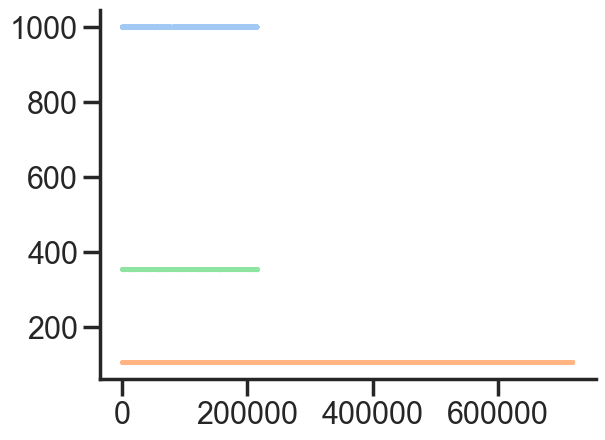

[   85608.    85961.    86314. ... 76499529. 76499882. 76500235.]
[  155888.   155994.   156100. ... 76451228. 76451334. 76451440.]
camera [200] [215985]
[215785]
215986 720257 216417
nt [4] [719280]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334] [7192.50044479 7192.50044479 7192.50044479 7192.50044479 7192.50044479
 7192.50044479 7192.50044479 7192.50044479 7192.50044479 7192.50044479
 7192.50044479 7192.50044479 7192.50044479 7192.50044479 7192.50044479
 7192.50044479 7192.50044479 7192.50044479 7192.50044479 7192.50044479
 7192.50044479 7192.50044479 7192.50044479 7192.50044479 7192.50044479
 7192.50044479 7192.50044479 7192.50044479 7192.50044479 7192.50044479
 7192.50044479 7192.50044479 7192.50044479 7192.50044479 7192.50044479
 7192.50044479]
Deviation of [125.48854484] in miliseconds
Deviation at start [-7.9296] in miliseconds
Deviation at end [1.5104] in miliseconds
experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\

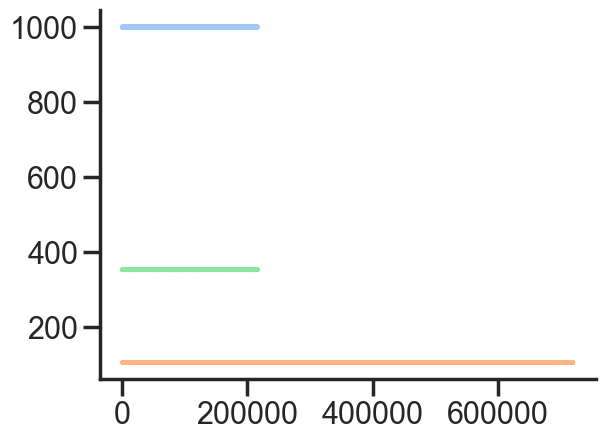

[   91209.    91562.    91915. ... 76512166. 76512519. 76512872.]
[  163006.   163112.   163218. ... 76467023. 76467129. 76467235.]
camera [204] [216306]
[216102]
216437 720339 216437
nt [3] [720335]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667] [7203.05917919 7203.05917919 7203.05917919 7203.05917919 7203.05917919
 7203.05917919 7203.05917919 7203.05917919 7203.05917919 7203.05917919
 7203.05917919 7203.05917919 7203.05917919 7203.05917919 7203.05917919
 7203.05917919 7203.05917919 7203.05917919 7203.05917919 7203.05917919
 7203.05917919 7203.05917919 7203.05917919 7203.05917919 7203.05917919
 7203.05917919 7203.05917919 7203.05917919 7203.05917919 7203.05917919
 7203.05917919 7203.05917919 7203.05917919 7203.05917919 7203.05917919
 7203.05917919]
Deviation of [151.58747819] in miliseconds
Deviation at start [-9.6288] in miliseconds
Deviation at end [4.9088] in miliseconds
experiment G:\My Drive\Fenton_Lab

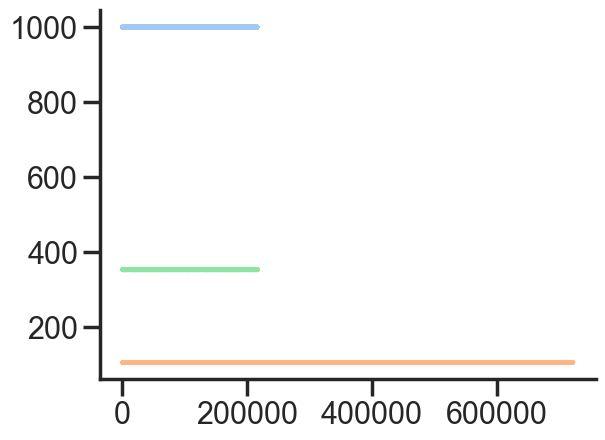

[  107373.   107726.   108079. ... 76682624. 76682977. 76683330.]
[  162701.   162806.   162912. ... 76632494. 76632600. 76632706.]
camera [157] [216453]
[216296]
216454 721904 216903
nt [2] [720884]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666] [7208.55892319 7208.55892319 7208.55892319 7208.55892319 7208.55892319
 7208.55892319 7208.55892319 7208.55892319 7208.55892319 7208.55892319
 7208.55892319 7208.55892319 7208.55892319 7208.55892319 7208.55892319
 7208.55892319 7208.55892319 7208.55892319 7208.55892319 7208.55892319
 7208.55892319 7208.55892319 7208.55892319 7208.55892319 7208.55892319
 7208.55892319 7208.55892319 7208.55892319 7208.55892319 7208.55892319
 7208.55892319 7208.55892319 7208.55892319 7208.55892319 7208.55892319
 7208.55892319]
Deviation of [148.7434782] in miliseconds
Deviation at start [-9.6288] in miliseconds
Deviation at end [4.0592] in miliseconds
experiment G:\M

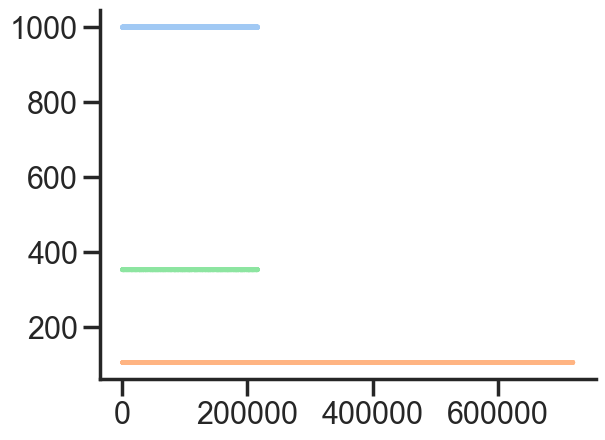

[5.4456000e+04 5.4809000e+04 5.5162000e+04 ... 7.6489010e+07 7.6489363e+07
 7.6489715e+07]
[  121828.   121934.   122040. ... 76437077. 76437183. 76437289.]
camera [191] [216355]
[216164]
216505 720445 216505
nt [1] [720442]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335] [7204.14949919 7204.14949919 7204.14949919 7204.14949919 7204.14949919
 7204.14949919 7204.14949919 7204.14949919 7204.14949919 7204.14949919
 7204.14949919 7204.14949919 7204.14949919 7204.14949919 7204.14949919
 7204.14949919 7204.14949919 7204.14949919 7204.14949919 7204.14949919
 7204.14949919 7204.14949919 7204.14949919 7204.14949919 7204.14949919
 7204.14949919 7204.14949919 7204.14949919 7204.14949919 7204.14949919
 7204.14949919 7204.14949919 7204.14949919 7204.14949919 7204.14949919
 7204.14949919]
Deviation of [141.33414486] in miliseconds
Deviation at start [-4.4368] in miliseconds
Deviation 

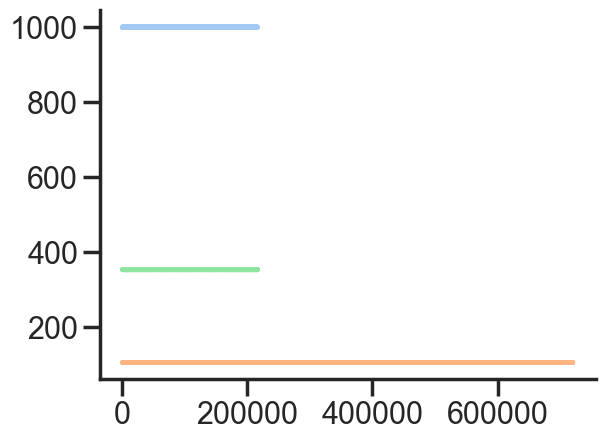

[5.7176000e+04 5.7528000e+04 5.7881000e+04 ... 7.6545630e+07 7.6545983e+07
 7.6546336e+07]
[   99455.    99561.    99667. ... 76451570. 76451676. 76451782.]
camera [120] [216297]
[216177]
216298 720793 216659
nt [1] [720481]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833] [7204.53974879 7204.53974879 7204.53974879 7204.53974879 7204.53974879
 7204.53974879 7204.53974879 7204.53974879 7204.53974879 7204.53974879
 7204.53974879 7204.53974879 7204.53974879 7204.53974879 7204.53974879
 7204.53974879 7204.53974879 7204.53974879 7204.53974879 7204.53974879
 7204.53974879 7204.53974879 7204.53974879 7204.53974879 7204.53974879
 7204.53974879 7204.53974879 7204.53974879 7204.53974879 7204.53974879
 7204.53974879 7204.53974879 7204.53974879 7204.53974879 7204.53974879
 7204.53974879]
Deviation of [143.55121153] in miliseconds
Deviation at start [-2.6432] in miliseconds

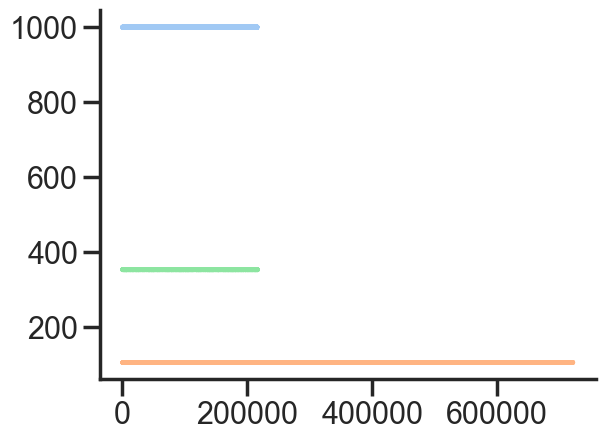

[   80071.    80424.    80777. ... 76604019. 76604372. 76604725.]
[  131974.   132079.   132185. ... 76545204. 76545310. 76545416.]
camera [147] [216310]
[216163]
216311 721370 216758
nt [1] [720439]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666] [7204.11929119 7204.11929119 7204.11929119 7204.11929119 7204.11929119
 7204.11929119 7204.11929119 7204.11929119 7204.11929119 7204.11929119
 7204.11929119 7204.11929119 7204.11929119 7204.11929119 7204.11929119
 7204.11929119 7204.11929119 7204.11929119 7204.11929119 7204.11929119
 7204.11929119 7204.11929119 7204.11929119 7204.11929119 7204.11929119
 7204.11929119 7204.11929119 7204.11929119 7204.11929119 7204.11929119
 7204.11929119 7204.11929119 7204.11929119 7204.11929119 7204.11929119
 7204.11929119]
Deviation of [150.07547819] in miliseconds
Deviation at start [-9.6288] in miliseconds
Devia

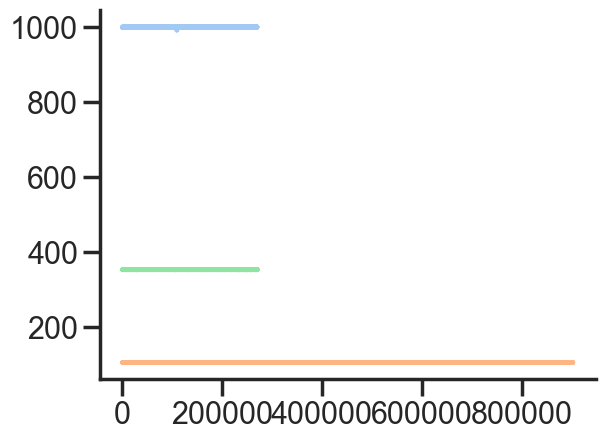

[8.5149000e+04 8.5502000e+04 8.5855000e+04 ... 9.5736157e+07 9.5736510e+07
 9.5736863e+07]
[  145744.   145850.   145956. ... 95777671. 95777777. 95777883.]
camera [172] [270553]
[270381]
270554 902801 270902
nt [2] [901252]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333] [9012.17438559 9012.17438559 9012.17438559 9012.17438559 9012.17438559
 9012.17438559 9012.17438559 9012.17438559 9012.17438559 9012.17438559
 9012.17438559 9012.17438559 9012.17438559 9012.17438559 9012.17438559
 9012.17438559 9012.17438559 9012.17438559 9012.17438559 9012.17438559
 9012.17438559 9012.17438559 9012.17438559 9012.17438559 9012.17438559
 9012.17438559 9012.17438559 9012.17438559 9012.17438559 9012.17438559
 9012.17438559 9012.17438559 9012.17438559 9012.17438559 9012.17438559
 9012.17438559]
Deviation of [184.34774775] in miliseconds
Devia

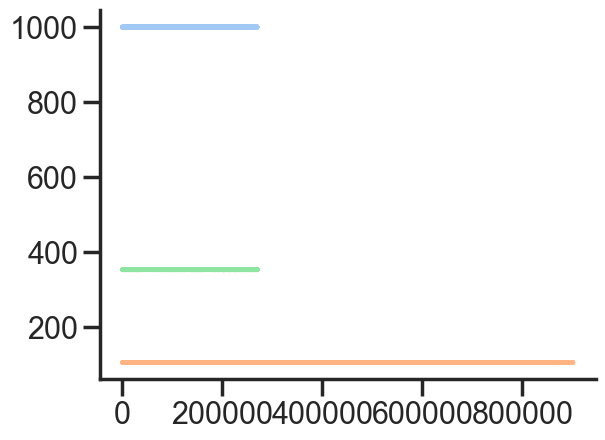

[4.5664000e+04 4.6017000e+04 4.6370000e+04 ... 9.5640397e+07 9.5640750e+07
 9.5641102e+07]
[  100057.   100162.   100268. ... 95591298. 95591404. 95591510.]
camera [155] [270264]
[270109]
270265 901473 270743
nt [4] [900346]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667] [9003.09357759 9003.09357759 9003.09357759 9003.09357759 9003.09357759
 9003.09357759 9003.09357759 9003.09357759 9003.09357759 9003.09357759
 9003.09357759 9003.09357759 9003.09357759 9003.09357759 9003.09357759
 9003.09357759 9003.09357759 9003.09357759 9003.09357759 9003.09357759
 9003.09357759 9003.09357759 9003.09357759 9003.09357759 9003.09357759
 9003.09357759 9003.09357759 9003.09357759 9003.09357759 9003.09357759
 9003.09357759 9003.09357759 9003.09357759 9003.09357759 9003.09357759
 9003.09357759]
Deviation of [187.98908107] i

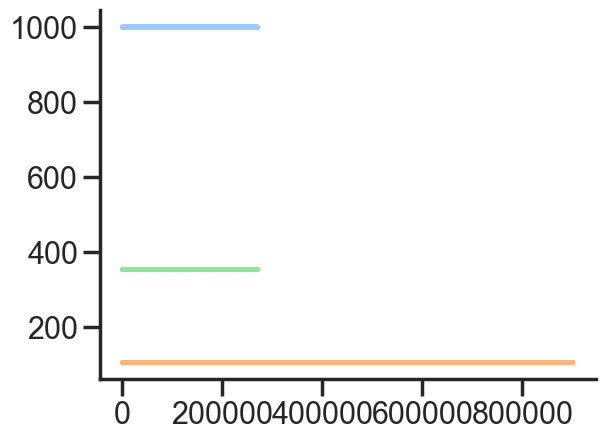

[5.7658000e+04 5.8011000e+04 5.8364000e+04 ... 9.5690911e+07 9.5691264e+07
 9.5691617e+07]
[  126263.   126369.   126475. ... 95604982. 95605088. 95605194.]
camera [195] [270607]
[270412]
270853 901355 270853
nt [3] [901353]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667] [9013.17106079 9013.17106079 9013.17106079 9013.17106079 9013.17106079
 9013.17106079 9013.17106079 9013.17106079 9013.17106079 9013.17106079
 9013.17106079 9013.17106079 9013.17106079 9013.17106079 9013.17106079
 9013.17106079 9013.17106079 9013.17106079 9013.17106079 9013.17106079
 9013.17106079 9013.17106079 9013.17106079 9013.17106079 9013.17106079
 9013.17106079 9013.17106079 9013.17106079 9013.17106079 9013.17106079
 9013.17106079 9013.17106079 9013.17106079 9013.17106079 9013.17106079
 9013.17106079]
Deviation 

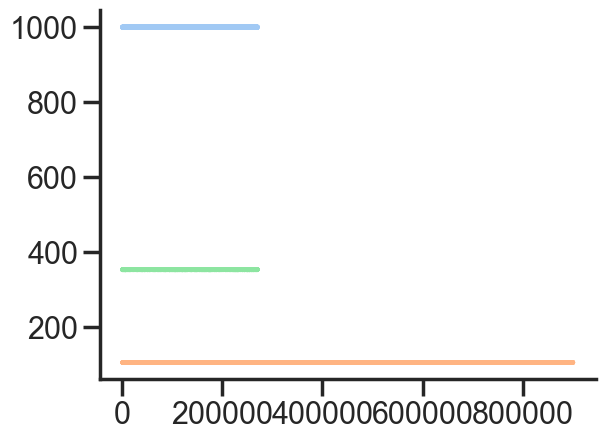

[7.3789000e+04 7.4142000e+04 7.4495000e+04 ... 9.5639546e+07 9.5639899e+07
 9.5640252e+07]
[  136214.   136320.   136426. ... 95567581. 95567687. 95567793.]
camera [177] [270457]
[270280]
270664 900908 270664
nt [1] [900904]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666] [9008.70103199 9008.70103199 9008.70103199 9008.70103199 9008.70103199
 9008.70103199 9008.70103199 9008.70103199 9008.70103199 9008.70103199
 9008.70103199 9008.70103199 9008.70103199 9008.70103199 9008.70103199
 9008.70103199 9008.70103199 9008.70103199 9008.70103199 9008.70103199
 9008.70103199 9008.70103199 9008.70103199 9008.70103199 9008.70103199
 9008.70103199 9008.70103199 9008.70103199 9008.70103199 9008.70103199
 9008.70103199 9008.70103199 9008.70103199 9008.70103199 9008.70103199
 9008.7

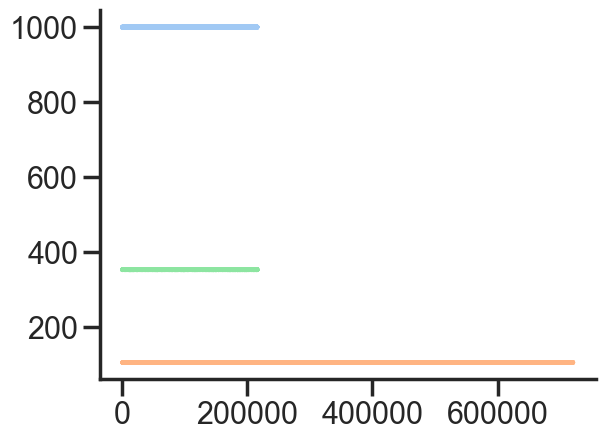

[  117557.   117910.   118263. ... 76526731. 76527084. 76527437.]
[  158043.   158149.   158255. ... 76492415. 76492521. 76492627.]
camera [115] [216205]
[216090]
216206 720626 216409
nt [2] [720276]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665] [7202.47484319 7202.47484319 7202.47484319 7202.47484319 7202.47484319
 7202.47484319 7202.47484319 7202.47484319 7202.47484319 7202.47484319
 7202.47484319 7202.47484319 7202.47484319 7202.47484319 7202.47484319
 7202.47484319 7202.47484319 7202.47484319 7202.47484319 7202.47484319
 7202.47484319 7202.47484319 7202.47484319 7202.47484319 7202.47484319
 7202.47484319 7202.47484319 7202.47484319 7202.47484319 7202.47484319
 7202.47484319 7202.47484319 7202.47484319 7202.47484319 7202.47484319
 7202.474843

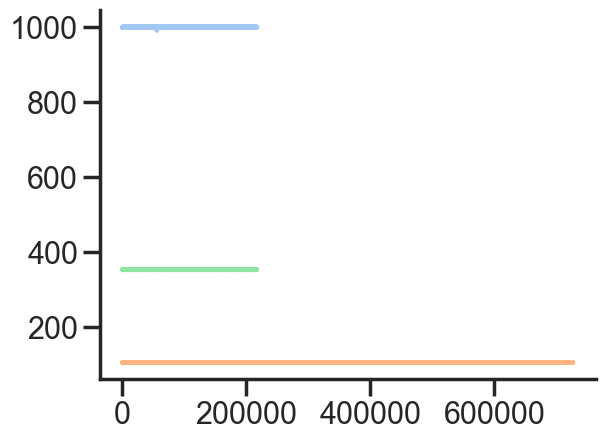

[6.2515000e+04 6.2868000e+04 6.3221000e+04 ... 7.6646117e+07 7.6646470e+07
 7.6646823e+07]
[  112970.   113076.   113182. ... 77105577. 77105683. 77105789.]
camera [143] [216901]
[216758]
216902 726840 216902
nt [1] [722506]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296] [7224.78363999 7224.78363999 7224.78363999 7224.78363999 7224.78363999
 7224.78363999 7224.78363999 7224.78363999 7224.78363999 7224.78363999
 7224.78363999 7224.78363999 7224.78363999 7224.78363999 7224.78363999
 7224.78363999 7224.78363999 7224.78363999 7224.78363999 7224.78363999
 7224.78363999 7224.78363999 7224.78363999 7224.78363999 7224.78363999
 7224.78363999 7224.78363999 7224.78363999 7224.78363999 7224.78363999
 7224.78363999 7224.78363999 7224.78363999 7224

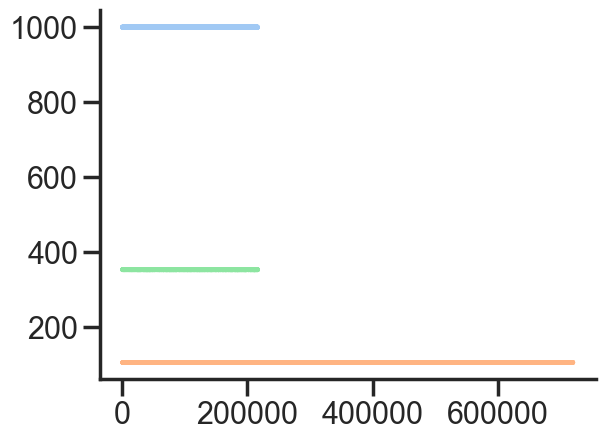

[5.3592000e+04 5.3945000e+04 5.4298000e+04 ... 7.6536107e+07 7.6536460e+07
 7.6536813e+07]
[  111262.   111368.   111474. ... 76401774. 76401880. 76401986.]
camera [164] [216250]
[216086]
216251 720212 216639
nt [3] [720190]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665] [7201.60428639 7201.60428639 7201.60428639 7201.60428639 7201.60428639
 7201.60428639 7201.60428639 7201.60428639 7201.60428639 7201.60428639
 7201.60428639 7201.60428639 7201.60428639 7201.60428639 7201.60428639
 7201.60428639 7201.60428639 7201.60428639 7201.60428639 7201.60428639
 7201.60428639 7201.60428639 7201.60428639 7201.60428639 7201.60428639
 7201.60428639 7201.60428639 7201.60428639 7201.60428639 7201.60428639
 7201.60428639 7201.6042863

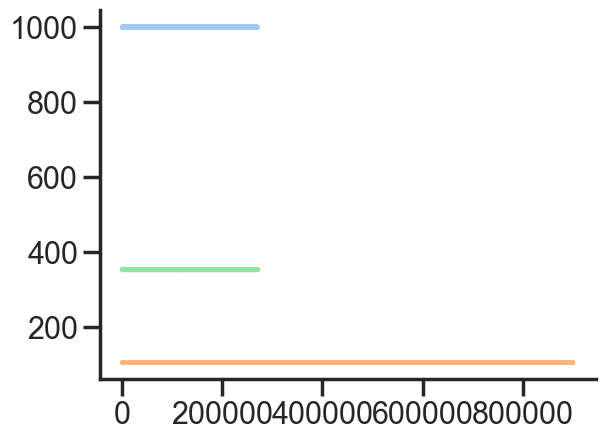

[3.2351000e+04 3.2705000e+04 3.3058000e+04 ... 9.5535001e+07 9.5535354e+07
 9.5535707e+07]
[8.8819000e+04 8.8925000e+04 8.9031000e+04 ... 9.5490906e+07 9.5491012e+07
 9.5491117e+07]
camera [160] [270040]
[269880]
270041 900631 270514
nt [1] [899474]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667] [8994.40736159 8994.40736159 8994.40736159 8994.40736159 8994.40736159
 8994.40736159 8994.40736159 8994.40736159 8994.40736159 8994.40736159
 8994.40736159 8994.40736159 8994.40736159 8994.40736159 8994.40736159
 8994.40736159 8994.40736159 8994.40736159 8994.40736159 8994.40736159
 8994.40736159 8994.40736159 8994.40736159 8994.40736159 8994.40736159
 8994.40736159 8994.40736159 8994.40736159 8994.407361

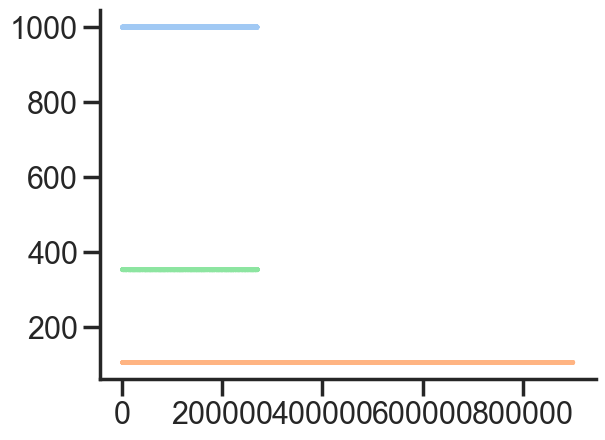

[4.2056000e+04 4.2409000e+04 4.2762000e+04 ... 9.5570325e+07 9.5570678e+07
 9.5571031e+07]
[9.2498000e+04 9.2604000e+04 9.2710000e+04 ... 9.5519040e+07 9.5519146e+07
 9.5519252e+07]
camera [143] [270150]
[270007]
270151 900862 270587
nt [1] [899896]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334] [8998.62590879 8998.62590879 8998.62590879 8998.62590879 8998.62590879
 8998.62590879 8998.62590879 8998.62590879 8998.62590879 8998.62590879
 8998.62590879 8998.62590879 8998.62590879 8998.62590879 8998.62590879
 8998.62590879 8998.62590879 8998.62590879 8998.62590879 8998.62590879
 8998.62590879 8998.62590879 8998.62590879 8998.62590879 8998.62590879
 8998.62590879 8998.62590879 8998.6

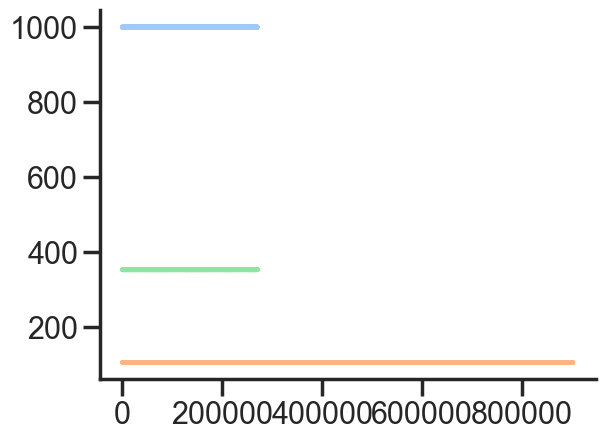

[4.0074000e+04 4.0427000e+04 4.0781000e+04 ... 9.5663789e+07 9.5664142e+07
 9.5664495e+07]
[   96729.    96835.    96941. ... 95635980. 95636086. 95636192.]
camera [161] [270581]
[270420]
270582 901926 270855
nt [2] [901282]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334] [9012.47552159 9012.47552159 9012.47552159 9012.47552159 9012.47552159
 9012.47552159 9012.47552159 9012.47552159 9012.47552159 9012.47552159
 9012.47552159 9012.47552159 9012.47552159 9012.47552159 9012.47552159
 9012.47552159 9012.47552159 9012.47552159 9012.47552159 9012.47552159
 9012.47552159 9012.47552159 9012.47552159 9012.47552159 9012.47552159
 9012.47552159 9012.47552159 9012.4755215

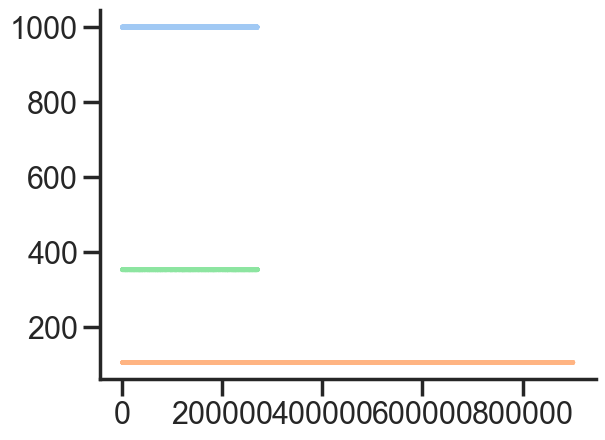

[3.8943000e+04 3.9295000e+04 3.9648000e+04 ... 9.5597267e+07 9.5597620e+07
 9.5597973e+07]
[8.2401000e+04 8.2507000e+04 8.2613000e+04 ... 9.5523037e+07 9.5523143e+07
 9.5523249e+07]
camera [124] [270225]
[270101]
270226 900995 270670
nt [3] [900219]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079] [9001.83635839 9001.83635839 9001.83635839 9001.83635839 9001.83635839
 9001.83635839 9001.83635839 9001.83635839 9001.83635839 9001.83635839
 9001.83635839 9001.83635839 9001.83635839 9001.83635839 9001.83635839
 9001.83635839 9001.83635839 9001.83635839 9001.83635839 9001.83635839
 9001.83635839 9001.83635839 9001.83635839 9001.83635839 9001.83635839
 9001

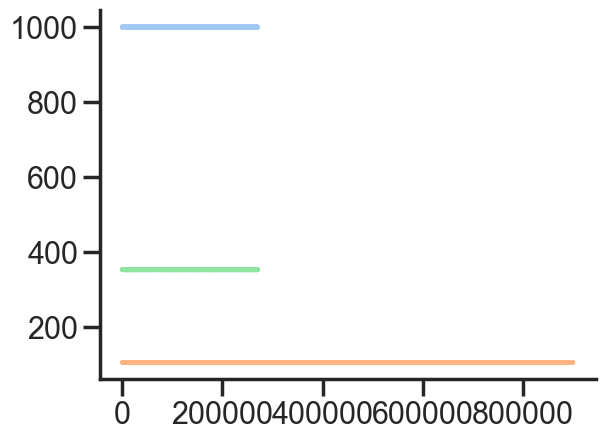

[3.8054000e+04 3.8407000e+04 3.8760000e+04 ... 9.5561144e+07 9.5561497e+07
 9.5561850e+07]
[8.2218000e+04 8.2324000e+04 8.2430000e+04 ... 9.5459079e+07 9.5459185e+07
 9.5459291e+07]
camera [126] [270280]
[270154]
270326 900393 270572
nt [3] [900390]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333] [9003.54565919 9003.54565919 9003.54565919 9003.54565919 9003.54565919
 9003.54565919 9003.54565919 9003.54565919 9003.54565919 9003.54565919
 9003.54565919 9003.54565919 9003.54565919 9003.54565919 9003.54565919
 9003.54565919 9003.54565919 9003.54565919 9003.54565919 9003.54565919
 9003.54565919 9003.54565919 9003.54565919 9003.54565919 

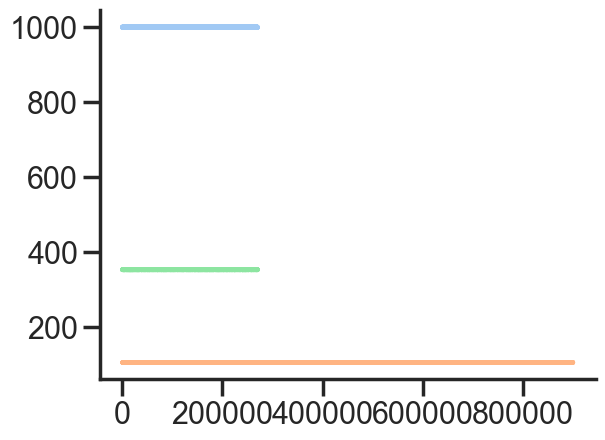

[9.0523000e+04 9.0876000e+04 9.1229000e+04 ... 9.5567054e+07 9.5567406e+07
 9.5567759e+07]
[  144563.   144669.   144775. ... 95518443. 95518549. 95518655.]
camera [154] [270296]
[270142]
270437 900365 270437
nt [4] [900360]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333] [9003.23423359 9003.23423359 9003.23423359 9003.23423359 9003.23423359
 9003.23423359 9003.23423359 9003.23423359 9003.23423359 9003.23423359
 9003.23423359 9003.23423359 9003.23423359 9003.23423359 9003.23423359
 9003.23423359 9003.23423359 9003.23423359 9003.23423359 9003.23423359
 9003.23423359 9003.23423359 9003.23423359 9003.23423359 9003.2

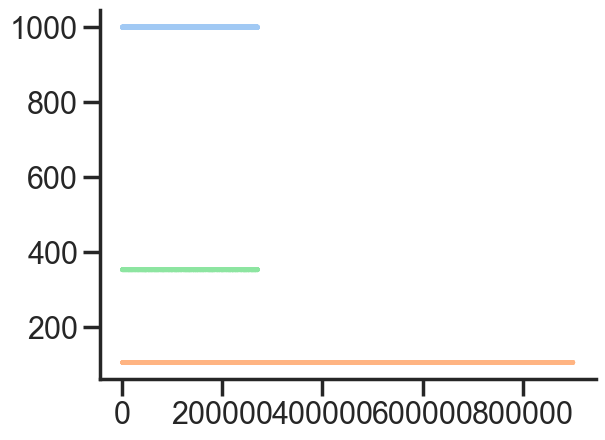

[9.0399000e+04 9.0751000e+04 9.1104000e+04 ... 9.5623084e+07 9.5623438e+07
 9.5623791e+07]
[  161538.   161644.   161750. ... 95569720. 95569826. 95569932.]
camera [202] [270444]
[270242]
270598 900689 270598
nt [2] [900686]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667] [9006.51236799 9006.51236799 9006.51236799 9006.51236799 9006.51236799
 9006.51236799 9006.51236799 9006.51236799 9006.51236799 9006.51236799
 9006.51236799 9006.51236799 9006.51236799 9006.51236799 9006.51236799
 9006.51236799 9006.51236799 9006.51236799 9006.51236799 9006.51236799
 9006.51236799 9006.51236799 9006.51236799 9

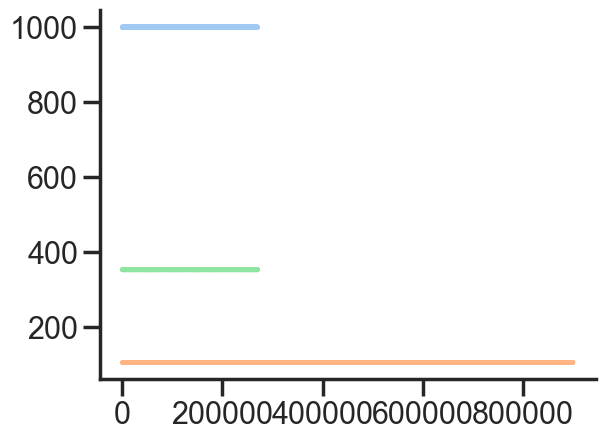

[4.4829000e+04 4.5181000e+04 4.5535000e+04 ... 9.5528711e+07 9.5529064e+07
 9.5529417e+07]
[9.4965000e+04 9.5071000e+04 9.5177000e+04 ... 9.5477206e+07 9.5477312e+07
 9.5477418e+07]
camera [142] [270309]
[270167]
270458 900444 270458
nt [1] [900440]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667, 9004.2471] [9004.06363199 9004.06363199 9004.06363199 9004.06363199 9004.06363199
 9004.06363199 9004.06363199 9004.06363199 9004.06363199 9004.06363199
 9004.06363199 9004.06363199 9004.06363199 9004.06363199 9004.06363199
 9004.06363199 9004.06363199 9004.06363199 9004.06363199 9004.06363199
 9004.06

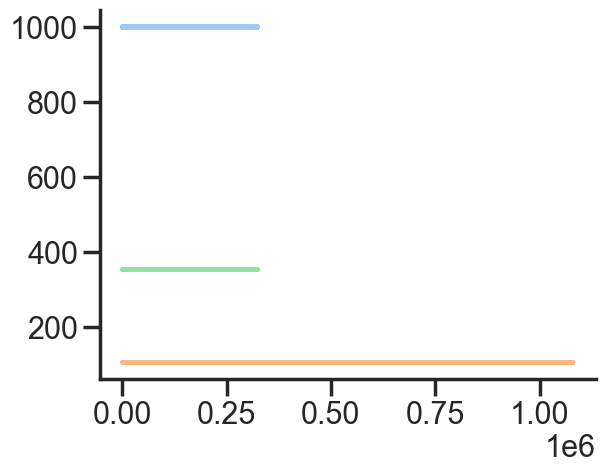

[4.08730000e+04 4.12260000e+04 4.15790000e+04 ... 1.14621216e+08
 1.14621569e+08 1.14621922e+08]
[8.44350000e+04 8.45410000e+04 8.46470000e+04 ... 1.14513145e+08
 1.14513251e+08 1.14513357e+08]
camera [124] [324240]
[324116]
324549 1080249 324549
nt [2] [1080246]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667, 9004.2471, 10802.2624] [10802.05021118 10802.05021118 10802.05021118 10802.05021118
 10802.05021118 10802.05021118 10802.05021118 10802.05021118
 10802.05021118 10802.05021118 10802.05021118 10802.05021118
 10802.05021118 10802.05021118 10802.05021118 10802.05021118
 10802.05021118 10802.

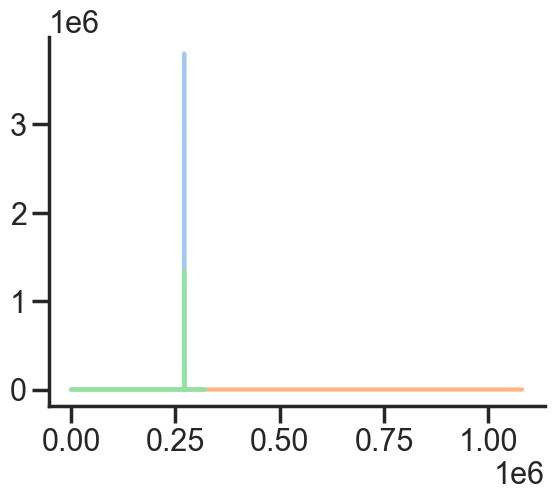

[4.08940000e+04 4.12470000e+04 4.16000000e+04 ... 1.14700529e+08
 1.14700882e+08 1.14701235e+08]
[7.57980000e+04 7.59040000e+04 7.60100000e+04 ... 1.14577087e+08
 1.14577193e+08 1.14577299e+08]
camera [99] [320618]
[320519]
320880 1080934 320971
nt [1] [1080929]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667, 9004.2471, 10802.2624, 10809.1058] [10808.89166238 10808.89166238 10808.89166238 10808.89166238
 10808.89166238 10808.89166238 10808.89166238 10808.89166238
 10808.89166238 10808.89166238 10808.89166238 10808.89166238
 10808.89166238 10808.89166238 10808.89166238 10808.89166238
 10808.8916

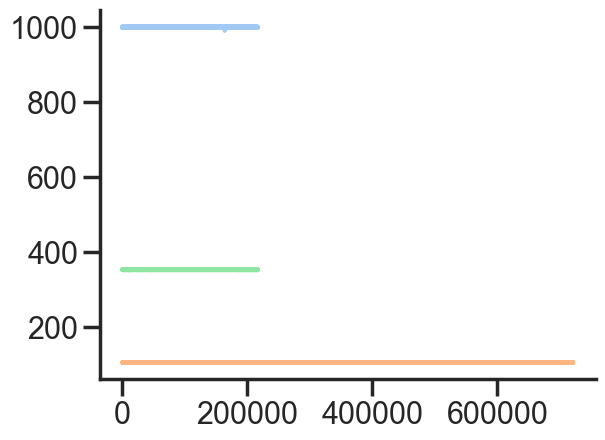

[4.2453000e+04 4.2806000e+04 4.3159000e+04 ... 7.6516847e+07 7.6517200e+07
 7.6517553e+07]
[   88607.    88713.    88819. ... 76459139. 76459245. 76459351.]
camera [131] [216450]
[216319]
216616 720967 216616
nt [1] [720965]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667, 9004.2471, 10802.2624, 10809.1058, 7209.523133333333] [7209.37822079 7209.37822079 7209.37822079 7209.37822079 7209.37822079
 7209.37822079 7209.37822079 7209.37822079 7209.37822079 7209.37822079
 7209.37822079 7209.37822079 7209.37822079 7209.37822079 7209.37822079
 7209.37822079 7209.37822079 7209.37822079 7209.37822079 7209

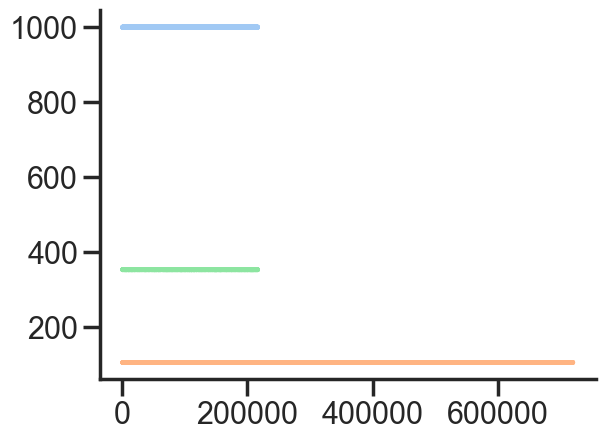

[7.2084000e+04 7.2437000e+04 7.2790000e+04 ... 7.6516877e+07 7.6517230e+07
 7.6517584e+07]
[  136729.   136835.   136941. ... 76434271. 76434376. 76434482.]
camera [184] [216297]
[216113]
216534 720278 216534
nt [4] [720274]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667, 9004.2471, 10802.2624, 10809.1058, 7209.523133333333, 7202.5974] [7202.43793279 7202.43793279 7202.43793279 7202.43793279 7202.43793279
 7202.43793279 7202.43793279 7202.43793279 7202.43793279 7202.43793279
 7202.43793279 7202.43793279 7202.43793279 7202.43793279 7202.43793279
 7202.43793279 7202.43793279 7202.43793279 7202.43

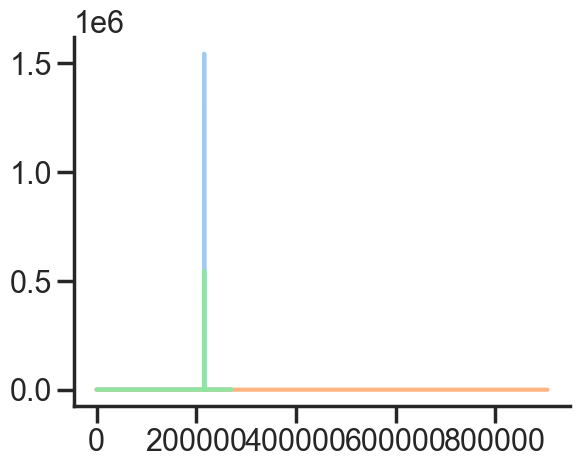

[4.3888000e+04 4.4242000e+04 4.4595000e+04 ... 9.5978040e+07 9.5978393e+07
 9.5978746e+07]
[9.2123000e+04 9.2229000e+04 9.2335000e+04 ... 9.5947431e+07 9.5947537e+07
 9.5947643e+07]
camera [137] [270108]
[269971]
270198 904910 270198
nt [2] [904905]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667, 9004.2471, 10802.2624, 10809.1058, 7209.523133333333, 7202.5974, 9048.897233333333] [9048.70104959 9048.70104959 9048.70104959 9048.70104959 9048.70104959
 9048.70104959 9048.70104959 9048.70104959 9048.70104959 9048.70104959
 9048.70104959 9048.70104959 9048.70104959 9048.70104959 9048.70104959
 9048.

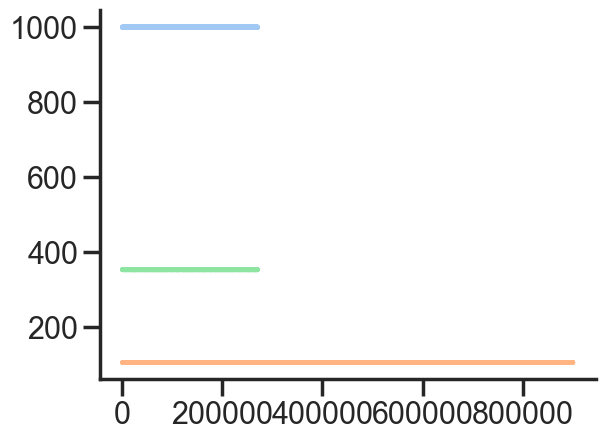

[6.5289000e+04 6.5642000e+04 6.5996000e+04 ... 9.5558764e+07 9.5559118e+07
 9.5559471e+07]
[  112179.   112285.   112391. ... 95509673. 95509779. 95509885.]
camera [133] [270349]
[270216]
270491 900588 270491
nt [1] [900585]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667, 9004.2471, 10802.2624, 10809.1058, 7209.523133333333, 7202.5974, 9048.897233333333, 9005.6943] [9005.51342719 9005.51342719 9005.51342719 9005.51342719 9005.51342719
 9005.51342719 9005.51342719 9005.51342719 9005.51342719 9005.51342719
 9005.51342719 9005.51342719 9005.51342719 9005.51342719 9005.51342719
 9005.51342719 9005.

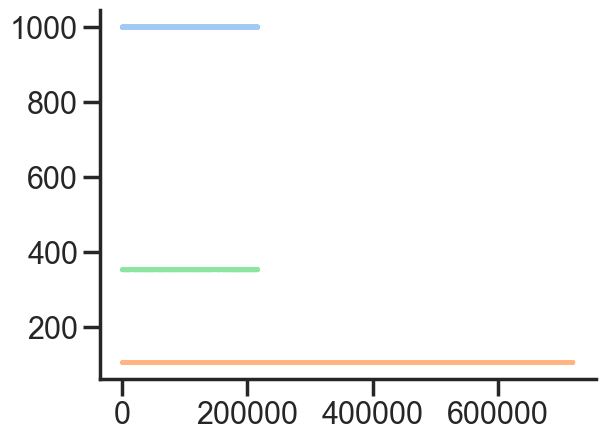

[5.6693000e+04 5.7046000e+04 5.7399000e+04 ... 7.6513149e+07 7.6513502e+07
 7.6513856e+07]
[  122848.   122954.   123060. ... 76415842. 76415948. 76416054.]
camera [188] [216292]
[216104]
216571 720235 216571
nt [2] [720230]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667, 9004.2471, 10802.2624, 10809.1058, 7209.523133333333, 7202.5974, 9048.897233333333, 9005.6943, 7202.166766666666] [7202.01860799 7202.01860799 7202.01860799 7202.01860799 7202.01860799
 7202.01860799 7202.01860799 7202.01860799 7202.01860799 7202.01860799
 7202.01860799 7202.01860799 7202.01860799 7202.01860799 7202.01860799
 

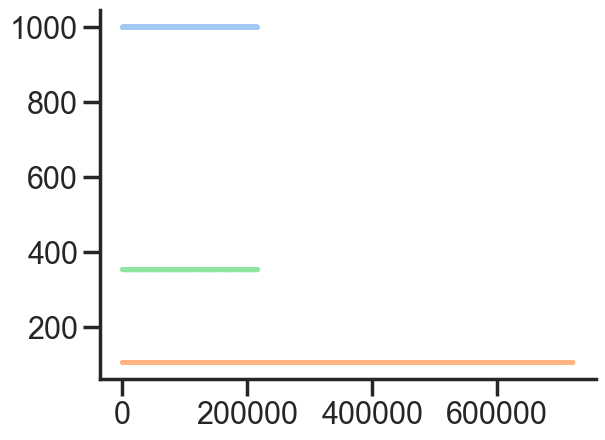

[6.8299000e+04 6.8652000e+04 6.9006000e+04 ... 7.6546304e+07 7.6546657e+07
 7.6547009e+07]
[  112235.   112341.   112446. ... 76516444. 76516550. 76516656.]
camera [125] [216545]
[216420]
216632 721285 216632
nt [2] [721283]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667, 9004.2471, 10802.2624, 10809.1058, 7209.523133333333, 7202.5974, 9048.897233333333, 9005.6943, 7202.166766666666, 7212.695266666667] [7212.54741759 7212.54741759 7212.54741759 7212.54741759 7212.54741759
 7212.54741759 7212.54741759 7212.54741759 7212.54741759 7212.54741759
 7212.54741759 7212.54741759 7212.54741759 7212.54741

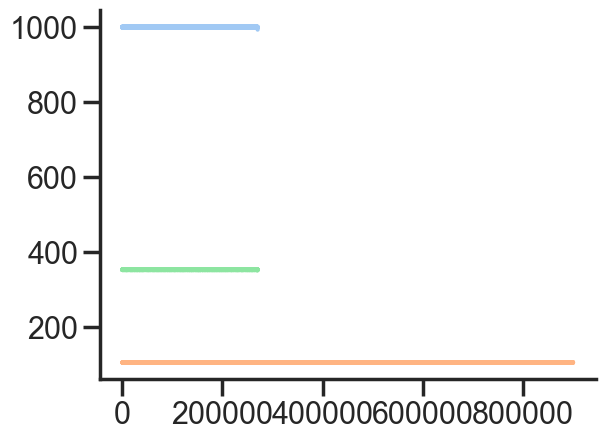

[7.3508000e+04 7.3861000e+04 7.4214000e+04 ... 9.5537947e+07 9.5538300e+07
 9.5538651e+07]
[  114094.   114200.   114306. ... 95481384. 95481490. 95481596.]
camera [115] [270249]
[270134]
270412 900303 270412
nt [1] [900300]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667, 9004.2471, 10802.2624, 10809.1058, 7209.523133333333, 7202.5974, 9048.897233333333, 9005.6943, 7202.166766666666, 7212.695266666667, 9002.850033333334] [9002.66216959 9002.66216959 9002.66216959 9002.66216959 9002.66216959
 9002.66216959 9002.66216959 9002.66216959 9002.66216959 9002.66216959
 9002.66216959 9002.66216959 9002.

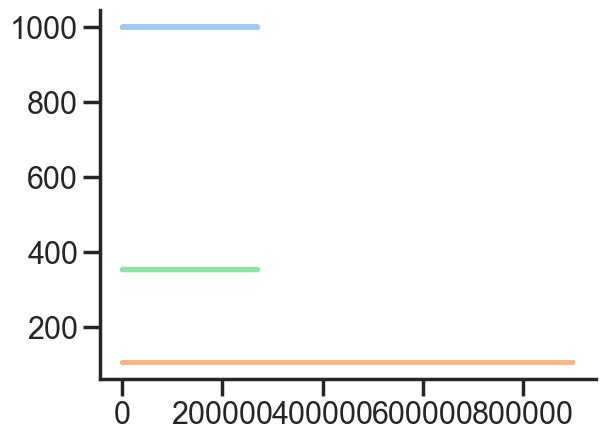

[6.6482000e+04 6.6835000e+04 6.7188000e+04 ... 9.5534455e+07 9.5534809e+07
 9.5535162e+07]
[  135862.   135968.   136074. ... 95491183. 95491289. 95491395.]
camera [197] [270293]
[270096]
270419 900190 270419
nt [2] [900185]
[7202.000933333334, 7423.529366666667, 7202.1657, 7200.771566666666, 7203.977266666667, 7192.625933333334, 7203.210766666667, 7208.707666666666, 7204.2908333333335, 7204.6833, 7204.269366666666, 9012.358733333333, 9003.281566666667, 9013.348366666667, 9008.886066666666, 7202.6313666666665, 7224.9296, 7201.7563666666665, 8994.584966666667, 8998.803033333334, 9012.648933333334, 9002.0079, 9003.714433333333, 9003.420133333333, 9006.693066666667, 9004.2471, 10802.2624, 10809.1058, 7209.523133333333, 7202.5974, 9048.897233333333, 9005.6943, 7202.166766666666, 7212.695266666667, 9002.850033333334, 9001.6876] [9001.50237119 9001.50237119 9001.50237119 9001.50237119 9001.50237119
 9001.50237119 9001.50237119 9001.50237119 9001.50237119 9001.50237119
 9001.50237119 9001.502

In [21]:
x_aln = []
y_aln = []
yaw_aln = []
speed_aln = []
duration = []
idx_camera = []
idx_camera_end = []
idx_nt = []
idx_nt_end = []

for ipath in range(0,len(x)):
    ipathsync = sync_path_matched[ipath]
    print('experiment',ipathsync)

    plt.plot(np.diff(ts_ephys_aln[ipath]))
    plt.plot(np.diff(nt_sync_aln[ipath]))
    plt.plot(np.diff(camera_sync_aln[ipath]))
    plt.show()

    print(camera_sync_aln[ipath])
    print(nt_sync_aln[ipath])
    
    _tmp_idx = []
    _tmp_idx = np.argwhere((camera_sync_aln[ipath] < nt_sync_aln[ipath][-1])==True)[-1]
    
    if ts_ephys_aln[ipath].size >= _tmp_idx:
        #Just to allign the camera with the sync, having the first frame of behavior and the last one
        idx_camera.append(np.argwhere((camera_sync_aln[ipath] > nt_sync_aln[ipath][0])==True)[0])
        idx_camera_end.append(np.argwhere((camera_sync_aln[ipath] < nt_sync_aln[ipath][-1])==True)[-1])
 
    if ts_ephys_aln[ipath].size < _tmp_idx:
        #Just to allign the camera with the sync, having the first frame of behavior and the last one
        idx_camera.append(np.argwhere((camera_sync_aln[ipath] > nt_sync_aln[ipath][0])==True)[0])
        idx_camera_end.append(np.array([ts_ephys_aln[ipath].size-1]).astype(int))
         
    
    print('camera',idx_camera[ipath],idx_camera_end[ipath])
    print(idx_camera_end[ipath]-idx_camera[ipath])


    print(ts_ephys_aln[ipath].size,nt_sync_aln[ipath].size,camera_sync_aln[ipath].size)


    duration.append(((ts_ephys_aln[ipath][idx_camera_end[ipath]] - ts_ephys_aln[ipath][idx_camera[ipath]]) /30000)[0])

    idx_nt.append(np.argwhere((nt_sync_aln[ipath] > camera_sync_aln[ipath][idx_camera[ipath]])==True)[0])
    idx_nt_end.append(np.argwhere((nt_sync_aln[ipath] < camera_sync_aln[ipath][idx_camera_end[ipath]])==True)[-1])
    print('nt',idx_nt[ipath],idx_nt_end[ipath])

    print(duration,(nt_sync_aln[ipath][idx_nt_end[ipath]] - nt_sync_aln[ipath][idx_nt[ipath]]) /ioFS)
    print('Deviation of',(duration[ipath] - (nt_sync_aln[ipath][idx_nt_end[ipath]] - nt_sync_aln[ipath][idx_nt[ipath]]) /ioFS[ipath]) * 1000, 'in miliseconds')
    print('Deviation at start',((camera_sync_aln[ipath][idx_camera[ipath]] - nt_sync_aln[ipath][idx_nt[ipath]])/ioFS[ipath]) * 1000,'in miliseconds')
    print('Deviation at end',((camera_sync_aln[ipath][idx_camera_end[ipath]] - nt_sync_aln[ipath][idx_nt_end[ipath]])/ioFS[ipath]) * 1000,'in miliseconds')

    
    
    ## align behavior

    x_aln.append(x[ipath][int(idx_nt[ipath][0]):int(idx_nt_end[ipath][0])])
    y_aln.append(y[ipath][int(idx_nt[ipath][0]):int(idx_nt_end[ipath][0])])
    yaw_aln.append(yaw[ipath][int(idx_nt[ipath][0]):int(idx_nt_end[ipath][0])])
    speed_aln.append(speed[ipath][int(idx_nt[ipath][0]):int(idx_nt_end[ipath][0])])

In [22]:
## get lfp paths

In [23]:
#Example of how to append two files together
path_lfp = Path(r'Z:\NeuroPix\Ketamine\\')
dlc_path = path_lfp

files = dlc_path.glob('**/*.imec1.lf.bin')
HPC_lfp_path=[]

# files = os.listdir(dlc_path)

for i in files:
    
    if 'De_nosing' in str(i):
        break    
        
    HPC_lfp_path.append(i)
    print(i)


Z:\NeuroPix\Ketamine\2022-07-25-M015_SAL_mPFC_HPC_0.09_0.3_0.9ml_g0\2022-07-25-M015_SAL_mPFC_HPC_0.09_0.3_0.9ml_g0_imec1\2022-07-25-M015_SAL_mPFC_HPC_0.09_0.3_0.9ml_g0_t0.imec1.lf.bin
Z:\NeuroPix\Ketamine\2022-07-27-07-41-00_M015_SAL_PFC_HPC_0_0_0mpk\07-27-2022-M015_SAL_0.09_0.3_0.9_g0_imec1\07-27-2022-M015_SAL_0.09_0.3_0.9_g0_t0.imec1.lf.bin
Z:\NeuroPix\Ketamine\2022-07-28-13-19-00_M016_SAL_PFC_HPC_0_0_0mpk\07-28-2022_M016_SAL_0.09_0.3_0.9_g0_imec1\07-28-2022_M016_SAL_0.09_0.3_0.9_g0_t0.imec1.lf.bin
Z:\NeuroPix\Ketamine\2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk\2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_imec1\2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_t0.imec1.lf.bin
Z:\NeuroPix\Ketamine\2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk\2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_imec1\2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_t0.imec1.lf.bin
Z:\NeuroPix\Ketamine\2022-08-04_03-45-00_M016_RSK_mPFC_HPC_3_10_30mpk\2022-08-04_03-45-00_M016_RSK_mPF

In [24]:
sorted(HPC_lfp_path)

[WindowsPath('Z:/NeuroPix/Ketamine/2022-07-25-M015_SAL_mPFC_HPC_0.09_0.3_0.9ml_g0/2022-07-25-M015_SAL_mPFC_HPC_0.09_0.3_0.9ml_g0_imec1/2022-07-25-M015_SAL_mPFC_HPC_0.09_0.3_0.9ml_g0_t0.imec1.lf.bin'),
 WindowsPath('Z:/NeuroPix/Ketamine/2022-07-27-07-41-00_M015_SAL_PFC_HPC_0_0_0mpk/07-27-2022-M015_SAL_0.09_0.3_0.9_g0_imec1/07-27-2022-M015_SAL_0.09_0.3_0.9_g0_t0.imec1.lf.bin'),
 WindowsPath('Z:/NeuroPix/Ketamine/2022-07-28-13-19-00_M016_SAL_PFC_HPC_0_0_0mpk/07-28-2022_M016_SAL_0.09_0.3_0.9_g0_imec1/07-28-2022_M016_SAL_0.09_0.3_0.9_g0_t0.imec1.lf.bin'),
 WindowsPath('Z:/NeuroPix/Ketamine/2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk/2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_imec1/2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_t0.imec1.lf.bin'),
 WindowsPath('Z:/NeuroPix/Ketamine/2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk/2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_imec1/2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_t0.imec1.lf.bin'),
 WindowsPath('Z:/

In [25]:
## split path by \
root_lfp = []
for i in HPC_lfp_path:

    arr = []
    arr = [ x.strip() for x in str(i).split('\\') ]
    
    naming_convention = []
    naming_convention = arr[3]
    new = np.char.replace(naming_convention,'-','_')

    print(naming_convention)
    root_lfp.append(new)


2022-07-25-M015_SAL_mPFC_HPC_0.09_0.3_0.9ml_g0
2022-07-27-07-41-00_M015_SAL_PFC_HPC_0_0_0mpk
2022-07-28-13-19-00_M016_SAL_PFC_HPC_0_0_0mpk
2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk
2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk
2022-08-04_03-45-00_M016_RSK_mPFC_HPC_3_10_30mpk
2022-08-06-05-20-00_M016_RSK_mPFC_HPC_3_10_30mpk
2022-08-08-04-05-00_M017_SAL_mPFC_HPC_0_0_0mpk
2022-08-10-03-33-00_M017_RSK_mPFC_HPC_3_10_30mpk
2022-08-10-03-33-00_M017_RSK_mPFC_HPC_3_10_30mpk_2
2022-08-10-03-33-00_M017_RSK_mPFC_HPC_3_10_30mpk_all
2022-08-11-01-55-00_M018_SAL_mPFC_HPC_0_0_0mpk
2022-08-12-02-35-00_M017_RSK_mPFC_HPC_3_10_30mpk
2022-08-13-03-57-00_M018_RSK_mPFC_HPC_3_10_30mpk
2022-08-15-02-25-00_M018_RSK_mPFC_HPC_3_10_30mpk
2022-08-17-12-45-00_M019_1020_mPFC_HPC_1_3_10_30mpk
2022-08-17-12-45-00_M019_1020_mPFC_HPC_1_3_10_30mpk_2
2022-08-18-01-20-00_M020_1020_mPFC_HPC_1_3_10_30mpk
2022-08-19-04-25-00_M019_1020_mPFC_HPC_1_3_10_30mpk
2022-09-06-01-50-00-M021_1020_mPFC_HPC_1_3_10_30mpk
2022-09-0

In [26]:
## split path by \
HPC_lfp_path_matched = []
for i in ksort_HPC_path_matched:

    arr = []
    arr = [ x.strip() for x in str(i).split('\\') ]
    
    naming_convention = []
    naming_convention = arr[-1][:-9]
    new = []
    new = np.char.replace(naming_convention,'-','_')
    print(new)
    
    idx = root_lfp.index(new)
    
    print(HPC_lfp_path[idx])
    
    HPC_lfp_path_matched.append(HPC_lfp_path[idx])

2022_07_27_07_41_00_M015_SAL_PFC_HPC_0_0_0mpk
Z:\NeuroPix\Ketamine\2022-07-27-07-41-00_M015_SAL_PFC_HPC_0_0_0mpk\07-27-2022-M015_SAL_0.09_0.3_0.9_g0_imec1\07-27-2022-M015_SAL_0.09_0.3_0.9_g0_t0.imec1.lf.bin
2022_07_28_13_19_00_M016_SAL_PFC_HPC_0_0_0mpk
Z:\NeuroPix\Ketamine\2022-07-28-13-19-00_M016_SAL_PFC_HPC_0_0_0mpk\07-28-2022_M016_SAL_0.09_0.3_0.9_g0_imec1\07-28-2022_M016_SAL_0.09_0.3_0.9_g0_t0.imec1.lf.bin
2022_08_01_04_30_00_M015_RSK_mPFC_HPC_3_10_30mpk
Z:\NeuroPix\Ketamine\2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk\2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_imec1\2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_t0.imec1.lf.bin
2022_08_03_12_45_00_M015_RSK_mPFC_HPC_3_10_30mpk
Z:\NeuroPix\Ketamine\2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk\2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_imec1\2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_t0.imec1.lf.bin
2022_08_04_03_45_00_M016_RSK_mPFC_HPC_3_10_30mpk
Z:\NeuroPix\Ketamine\2022-08-04_03-45-00_M016_R

In [27]:
HPC_lfp_path_matched

[WindowsPath('Z:/NeuroPix/Ketamine/2022-07-27-07-41-00_M015_SAL_PFC_HPC_0_0_0mpk/07-27-2022-M015_SAL_0.09_0.3_0.9_g0_imec1/07-27-2022-M015_SAL_0.09_0.3_0.9_g0_t0.imec1.lf.bin'),
 WindowsPath('Z:/NeuroPix/Ketamine/2022-07-28-13-19-00_M016_SAL_PFC_HPC_0_0_0mpk/07-28-2022_M016_SAL_0.09_0.3_0.9_g0_imec1/07-28-2022_M016_SAL_0.09_0.3_0.9_g0_t0.imec1.lf.bin'),
 WindowsPath('Z:/NeuroPix/Ketamine/2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk/2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_imec1/2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_t0.imec1.lf.bin'),
 WindowsPath('Z:/NeuroPix/Ketamine/2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk/2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_imec1/2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk_g0_t0.imec1.lf.bin'),
 WindowsPath('Z:/NeuroPix/Ketamine/2022-08-04_03-45-00_M016_RSK_mPFC_HPC_3_10_30mpk/2022-08-04_03-45-00_M016_RSK_mPFC_HPC_3_10_30mpk_g0_imec1/2022-08-04_03-45-00_M016_RSK_mPFC_HPC_3_10_30mpk_g0_t0.imec1.lf.bin'),
 Wind

In [28]:
len(HPC_lfp_path_matched)

36

# about 2-3 min until this point !!

In [29]:
# ## save paths

# import pickle

# outputlist = []
# outputlist = [HPC_lfp_path_matched, x_aln, y_aln, yaw_aln, speed_aln,ksort_HPC_path_matched]

# # to save "processed" aligned data
# with open(r'C:\Users\fentonlab\Desktop\Local_copy_Ketamine_analysis\HPC_path_info_behavior.file', 'wb') as f:
#     pickle.dump(outputlist, f, pickle.HIGHEST_PROTOCOL)
# print('saved!')


In [30]:
## load behavior and path data

import pickle

HPC_lfp_path_matched, x_aln, y_aln, yaw_aln, speed_aln,ksort_HPC_path_matched = [],[],[],[],[],[]

# load data
with open(r'C:\Users\fentonlab\Desktop\Local_copy_Ketamine_analysis\HPC_path_info_behavior.file', 'rb') as f3:
    [HPC_lfp_path_matched, x_aln, y_aln, yaw_aln, speed_aln,ksort_HPC_path_matched] = pickle.load(f3)    
print('loaded!')

loaded!


### Electrophysiology - Load units - HPC probe

In [31]:
### file to load
ipath = 35

In [32]:
time_bin = 0.01 # 1/1250 # in seconds

fs = 30000

ksort_path = ksort_HPC_path_matched[ipath]
print('experiment',ksort_path)

cluster_info = []
cluster_info_path = ksort_path.joinpath('cluster_info.tsv')
cluster_group_path = ksort_path.joinpath('cluster_group.tsv')

try:
    cluster_info = pd.read_csv(cluster_info_path, sep='\t')
except:
    cluster_info = pd.read_csv(cluster_group_path, sep='\t')

# for screening look only at good units 
try:
    #cluster_info = cluster_info[cluster_info.group != 'noise']
    cluster_info = cluster_info[cluster_info.KSLabel == 'good']

#    cluster_info = cluster_info[cluster_info.group == 'good']
#    cluster_info = cluster_info[cluster_info.n_spikes > 100]
#    cluster_info = cluster_info[(cluster_info.group == 'good') * (cluster_info.depth > 1200)]

except:
    print('phy was not done')
    cluster_info = cluster_info[cluster_info.KSLabel == 'good']
    #cluster_info = cluster_info[cluster_info.KSLabel != 'noise']


spike_times = np.load(ksort_path.joinpath('spike_times.npy'))
spike_clusters = np.load(ksort_path.joinpath('spike_clusters.npy'))
templates = np.load(ksort_path.joinpath('templates.npy'))
spike_templates = np.load(ksort_path.joinpath('spike_templates.npy'))

# cid_channels = dict(zip(cluster_info.id.values, cluster_info.ch.values))
# cid_depth = dict(zip(cluster_info.id.values, cluster_info.depth.values))

df_spikes = pd.DataFrame({'times':spike_times.flatten()/30000.0, 
           'unit_id':spike_clusters.flatten(), 
           'templates':spike_templates.flatten() })
df_spikes.unit_id.unique().size



    # remove noise units
try:
    kslabel_d = dict(zip(cluster_info.id, cluster_info.group))
except:
    kslabel_d = dict(zip(cluster_info.cluster_id, cluster_info.KSLabel))

df_spikes['kslabel'] = df_spikes.unit_id.map(kslabel_d)
# remove noise units
df_spikes = df_spikes.dropna()
#     df_spikes_all.append(df_spikes)
print('allcells',df_spikes.unit_id.unique().size)

#     cids_to_keep = []
#     cids_to_keep = cluster_info[cluster_info['ch'].isin(ch_HPC_list[ipath])].cluster_id.values    
# #     print(cids_to_keep)
#     cids_to_keep_HPC_all.append(cids_to_keep)

start_offset = []
start_offset = int(ts_ephys_aln[ipath][idx_camera[ipath]])
print(start_offset,start_offset/fs)


## start with neurotar light recording
df_spk = []
df_spk = df_spikes.copy()
df_spk['spk'] = df_spikes['times']


df_spk= df_spk[(df_spk['spk'] >= (ts_ephys_aln[ipath][idx_camera[ipath]]/fs)[0]) & (df_spk['spk'] <= (ts_ephys_aln[ipath][idx_camera_end[ipath]]/fs)[0])]
df_spk.head()

df_spk['spk'] = df_spk['times'] - (ts_ephys_aln[ipath][idx_camera[ipath]]/fs)[0]
df_spk['spk'] 


df_units = []
df_units = bin_spk(df_spk, time_bin)  #0.01 is the time resolution to bin 0.01 s = 10ms


_inp_l = []
#     _inp_l = df_units[df_units['cids'].isin(cids_to_keep)].pivot('cids', 'times', 'hz').values[:, :]
_inp_l = df_units.pivot('cids', 'times', 'hz').values[:, :]

print('shape binned', _inp_l.shape)

spk_tmp = []

cids_good = []
cids_good = df_units.cids.unique()
print(cids_good.size)

channel_good = []
channel_good = cluster_info[cluster_info['cluster_id'].isin(cids_good)].ch.values    

experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\electrophysiology\2022-10-28-03-40-00_M033_CP101606_mPFC_HPC_1_3_10_30mpk_HPCprobe
allcells 301
385368 12.8456
shape binned (301, 900199)
301


In [33]:
# outputlist = []
# outputlist = [_inp_l, cids_good, channel_good]

# import pickle
# # to save "processed" aligned data
# with open(r'C:\Users\fentonlab\Desktop\Local_copy_Ketamine_analysis\spk_' + str(ipath) + '.file' , 'wb') as f:
#     pickle.dump(outputlist, f, pickle.HIGHEST_PROTOCOL)
# print('saved!')

In [34]:
whos

Variable                             Type              Data/Info
----------------------------------------------------------------
ExtractDigital                       function          <function ExtractDigital at 0x00000197A81C2670>
HPC_lfp_CA1_DG_fisure_detection_v3   function          <function HPC_lfp_CA1_DG_<...>v3 at 0x00000197A42E2280>
HPC_lfp_path                         list              n=57
HPC_lfp_path_matched                 list              n=36
Int2Volts                            function          <function Int2Volts at 0x00000197A81C2160>
Isomap                               type              <class 'sklearn.manifold._isomap.Isomap'>
NormalizeData                        function          <function NormalizeData at 0x00000197A42D49D0>
Parallel                             type              <class 'joblib.parallel.Parallel'>
Path                                 type              <class 'pathlib.Path'>
Pos_process                          function          <function Pos_pr

In [35]:
channel_good

array([  0,   1,   6,  15,  15,  14,  17,  14,  14,  14,  14,  15,  21,
        21,  18,  16,  19,  23,  23,  24,  21,  24,  24,  28,  26,  28,
        29,  24,  24,  32,  31,  31,  31,  29,  30,  35,  35,  34,  34,
        35,  35,  41,  41,  36,  36,  37,  42,  42,  45,  47,  44,  44,
        46,  47,  47,  47,  44,  44,  46,  45,  44,  45,  45,  47,  46,
        48,  44,  46,  53,  50,  50,  53,  55,  48,  57,  57,  56,  60,
        64,  64,  61,  61,  65,  61,  61,  66,  71,  68,  69,  72,  69,
        69,  75,  74,  81,  81,  81,  79,  79,  83,  82,  92,  90,  90,
        90,  97,  93,  93,  93,  98,  98,  97,  99, 104, 101, 101, 103,
        98, 102, 102, 104, 105, 107, 104, 104, 114, 114, 114, 119, 112,
       117, 119, 120, 119, 117, 115, 120, 123, 118, 123, 122, 118, 118,
       121, 121, 127, 127, 127, 125, 127, 125, 126, 128, 137, 135, 139,
       138, 142, 143, 148, 145, 146, 148, 148, 151, 150, 152, 151, 155,
       154, 153, 155, 154, 161, 165, 165, 168, 167, 164, 168, 16

In [36]:
cids_good = []
cids_good = df_units.cids.unique()
print(cids_good.size)

301


In [37]:
def barcode_plot(code):
    
    pixel_per_bar = 8
    dpi = 100
    
    fig = plt.figure(figsize=(40, 20), dpi=dpi)

    for idx,icode in enumerate(code):
        ax = fig.add_subplot(len(code),1,(idx+1))
        ax.set_axis_off()
        ax.imshow(icode.reshape(1, -1), cmap='binary', aspect='auto',
                  interpolation='nearest')
#         ax.set_ylabel(str(idx))
    plt.show()
    
    return

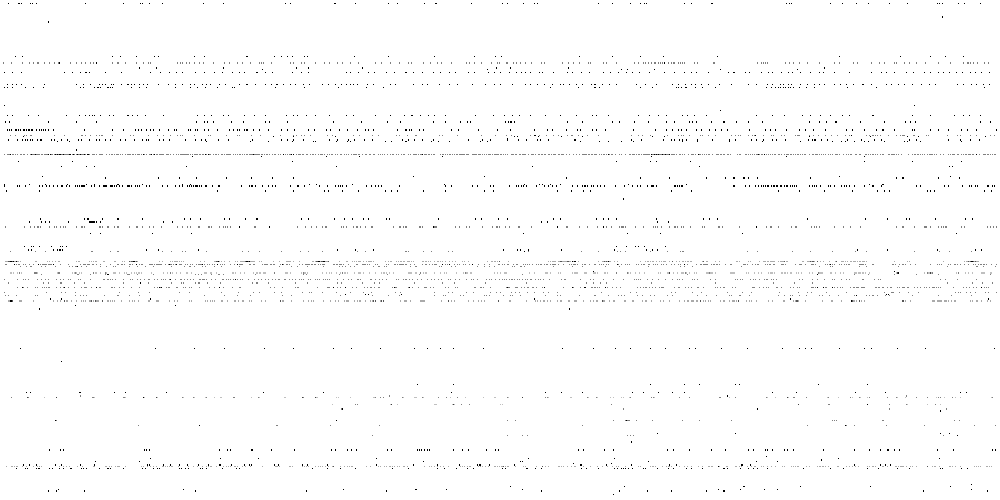

In [38]:
# spiking activity barcode plot
barcode_plot(list(_inp_l[:,1000:2000]))

In [39]:
## binned spikes in the chosen timebin ms

In [40]:
behavior = []
behavior = [x_aln[ipath],y_aln[ipath],yaw_aln[ipath],speed_aln[ipath]]

print(behavior[0].shape)

(900183,)


# load LFP data

In [41]:
#### Read LFP start/end time, HPC channels - Choose whether loading HPC or PFC here

pd.set_option('display.max_colwidth',100)
in_file = os.path.join(r'G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\lfp_aln_idx.csv')
Lfp_aln = pd.read_csv(in_file)

In [42]:
Lfp_aln.head()

,Lfp start,Lfp end,HPC ch start,HPC ch end,Name_file
0,24077,18029080,225,348,2022-07-27_07-41-00_M015_SAL_PFC_HPC_0_0_0mpk_HPCprobe
1,56145,18614969,225,324,2022-07-28_13-19-00_M016_SAL_PFC_HPC_0_0_0mpk_HPCprobe
2,87594,18093008,205,300,2022-08-01_04-30-00_M015_RSK_mPFC_HPC_3_10_30mpk_HPCprobe
3,62372,18064301,225,296,2022-08-03_12-45-00_M015_RSK_mPFC_HPC_3_10_30mpk_HPCprobe
4,58586,18068529,165,304,2022-08-04_03-45-00_M016_RSK_mPFC_HPC_3_10_30mpk_HPCprobe


In [43]:
#### Pull Lfp 'start' and 'end' for the specific recording 

start = Lfp_aln["Lfp start"][ipath] # starting of the trial in Lfp data points
end = Lfp_aln["Lfp end"][ipath] # end of trial

In [44]:
# load lfp

In [45]:
numChannels = 385
 
meta = readMeta(Path(HPC_lfp_path_matched[ipath]))

# 3A, 3B1, 3B2 (NP 1.0)
imroList = meta['imroTbl'].split(sep=')')[1:-1]
LFgain = np.array([int(i.split(sep=' ')[4]) for i in imroList])
fI2V = Int2Volts(meta)
conv = fI2V/LFgain
gain_correct = np.append(conv, 1)

rawDataLfp = []
dataLfp = []
rawDataLfp = np.memmap(Path(HPC_lfp_path_matched[ipath]), dtype='int16', mode='r')
dataLfp = np.reshape(rawDataLfp, (int(rawDataLfp.size/numChannels), numChannels))

del rawDataLfp    

In [46]:
## trim data to align with behavior

dataLfp = dataLfp[start:end,:]

In [47]:
dataLfp.shape[0]/2500

9001.6876

In [48]:
## mask for movment and stationary

In [49]:
speed_up, x_up, y_up = [],[],[]

speed_up = upsample_speed(behavior[3], dataLfp, LFP_rate = 2500, speed_rate = 100)
x_up = upsample_speed(behavior[0], dataLfp, LFP_rate = 2500, speed_rate = 100)
y_up = upsample_speed(behavior[1], dataLfp, LFP_rate = 2500, speed_rate = 100)

In [50]:
print(speed_up.shape, dataLfp.shape)

(22504219,) (22504219, 385)


experiment G:\My Drive\Fenton_Lab\Ketamine_analysis\Ketamine_data\Neurotar_HPC_ketamine\SPK\electrophysiology\2022-10-28-03-40-00_M033_CP101606_mPFC_HPC_1_3_10_30mpk_HPCprobe


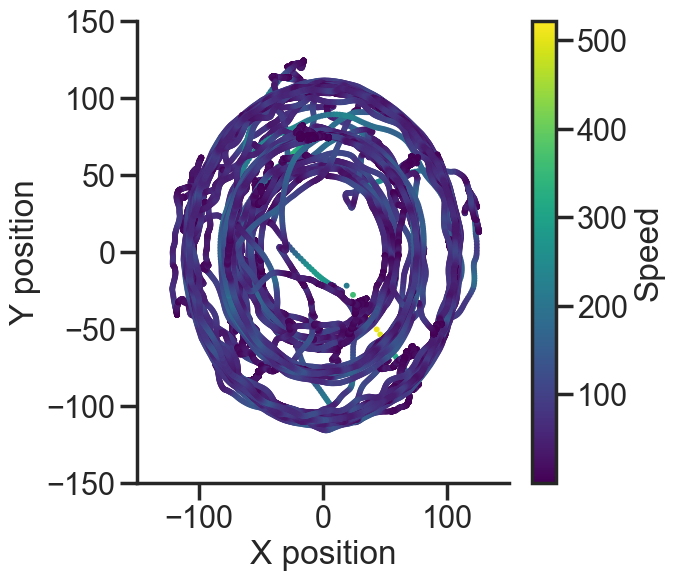

In [51]:
## plot upsampled x and y position as a function of speed

ksort_path = ksort_HPC_path_matched[ipath]
print('experiment',ksort_path)


fig = plt.figure(figsize = (6,6))
ax = fig.add_subplot(1,1,1)
p2 = ax.scatter(x_up[::25],y_up[::25], s=5, c= speed_up[::25], cmap = 'viridis')
fig.colorbar(p2, label='Speed')

ax.set_xlim(-150,150)
ax.set_ylim(-150,150)
ax.set_xlabel('X position')
ax.set_ylabel('Y position')

plt.show()

In [52]:
# cut Lfp and speed up to 2 h time window (disregard data above 2 h)
L = 2500*60*30*4 # time points in a 2 h time window
speed = speed_up[0:L]
dataLfp = dataLfp[0:L,:]

try:
    speed_periods = speed.reshape(-1,int(speed.size/4))  # reshape speed in baseline, low, mid, high injection time periods
except:
    speed_periods = speed.reshape(-1,int(speed_up.size/4))  # reshape speed in baseline, low, mid, high injection time periods


In [53]:
win_10 = 2500*60*10 # 30 min window 
Lfp_B = dataLfp[0:win_10,:]  # base line period

speed_B = speed_periods[0,:][0:win_10]

In [54]:
# make a speed map for low speed
win = 5000
th = 100 # speed threshold 
mask_mov_B = create_speed_mask(speed_B,win,th)

In [55]:
mask_mov_B.shape

(300,)

In [56]:
# reshape Lfp in trial x time window x channels
LfpRB = Lfp_B.reshape(int(Lfp_B.shape[0]/win),-1,Lfp_B.shape[1]) # reshape Lfp: trial x win length x channels
speed_RB = speed_B.reshape(int(speed_B.shape[0]/win),-1)

# mask Lfp: keep trials with high speed only
LfpB_mov = LfpRB[mask_mov_B,:,:]

In [57]:
LfpB_mov.shape

(8, 5000, 385)

(5000, 385)
385
(385, 5000)


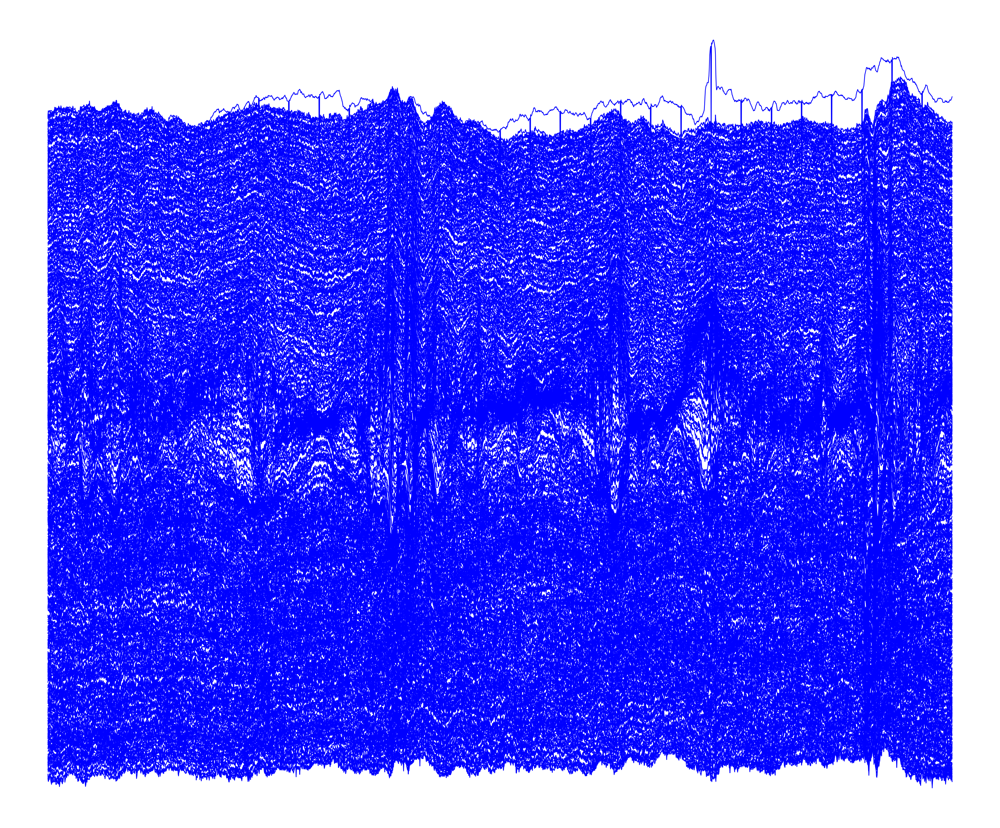

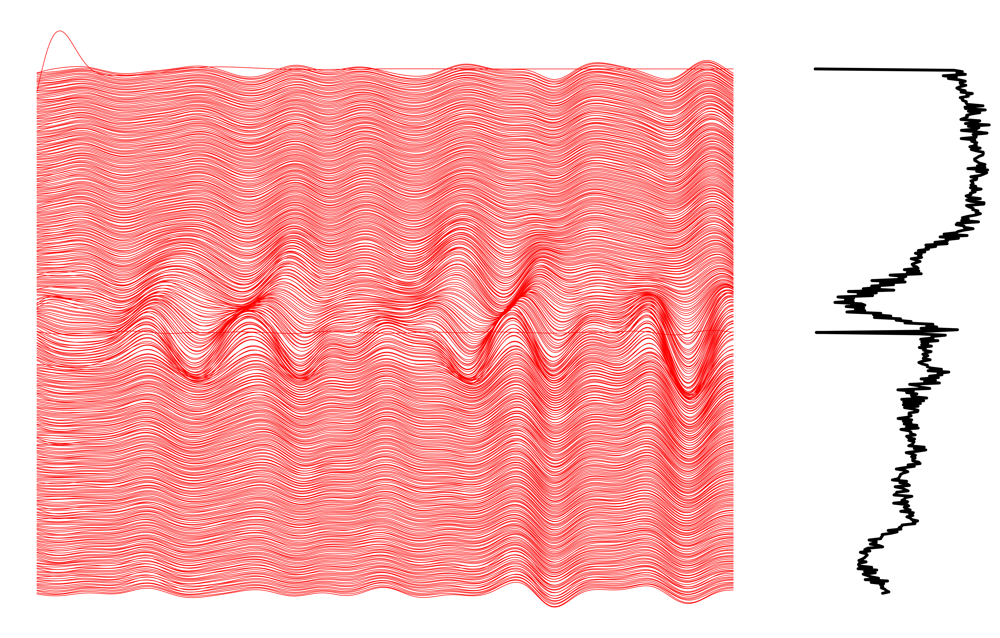

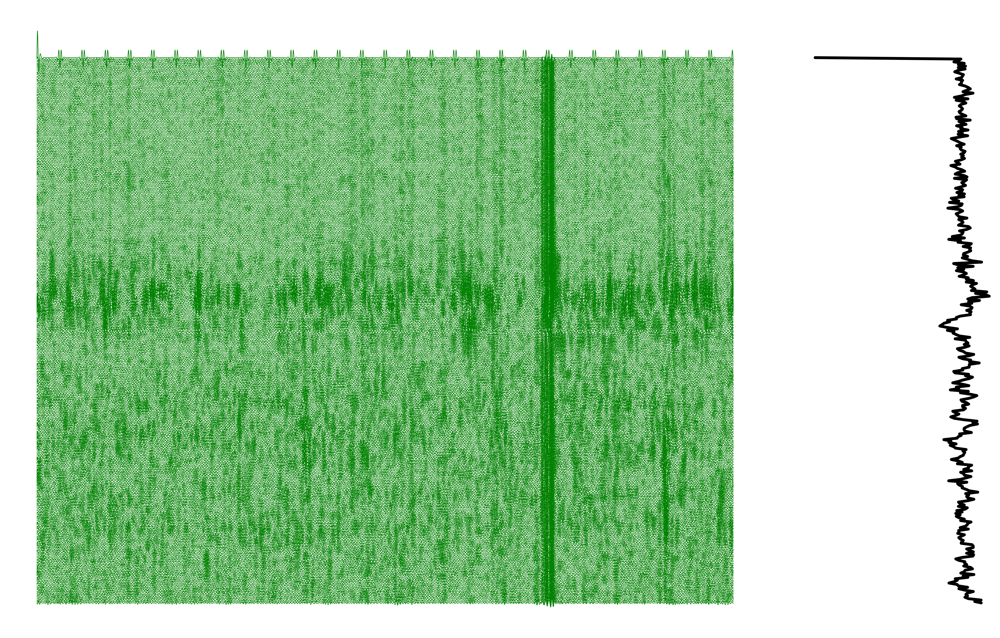

In [58]:

## plot raw data, theta and ripple band filter
## iterate through one second (2500 samples) time windows and plot 
for iwin in LfpB_mov[0:1]:
    
    lfp_current = []
    lfp_current = iwin*gain_correct[0]*1e6 ## in mV
    print(lfp_current.shape)

    ## plot raw lfp
    filtered_data = plot_lfps_theta(lfp_current, 1, int(2500*1),10)

In [59]:
##NOTE
## 800 um from fisure to end of CA1 (oriens included) -> ~40 channels (x2)
## 1200 um from fisure to end of DG (both upper and lower blades) -> ~60 channels (x2)

In [60]:
th = 3 # for low speed trials
mask_sta_B = create_sta_mask(speed_B,win,th)

In [61]:
mask_sta_B.shape

(300,)

In [62]:
# mask Lfp: keep trials with low speed only
LfpB_sta = LfpRB[mask_sta_B,:,:]

In [63]:
LfpB_sta.shape

(62, 5000, 385)

recid 35
(5000, 192)
theta channels [ 67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84
  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 101 102
 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120
 121]
91
192
192
(192, 5000)
fisure_candidates [ 1  3  4  7  8 18 19 20 21 22 22 23 26 26 27 29 31 34 37 40 51 62 79 85
 89 95]
absolute max min method [94 96]
absolute abs max method [94]
[ 67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84
  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 101 102
 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120
 121]
[ True False False False False False False False False False False False
 False]
ripple ch [ 70 102 103 104 105 106 107 108 109 110 111 112 113 114]
[[0]]
96
discrete filter coefficients: 
b = [ 0.164 0.236 0.325 0.430 0.546 0.667 0.783 0.882 0.956 0.995 0.995 0.956 0.882 0.783 0.667 0.546 0.430 0.325 0.236 0.164 ], 
a = [ 11.967

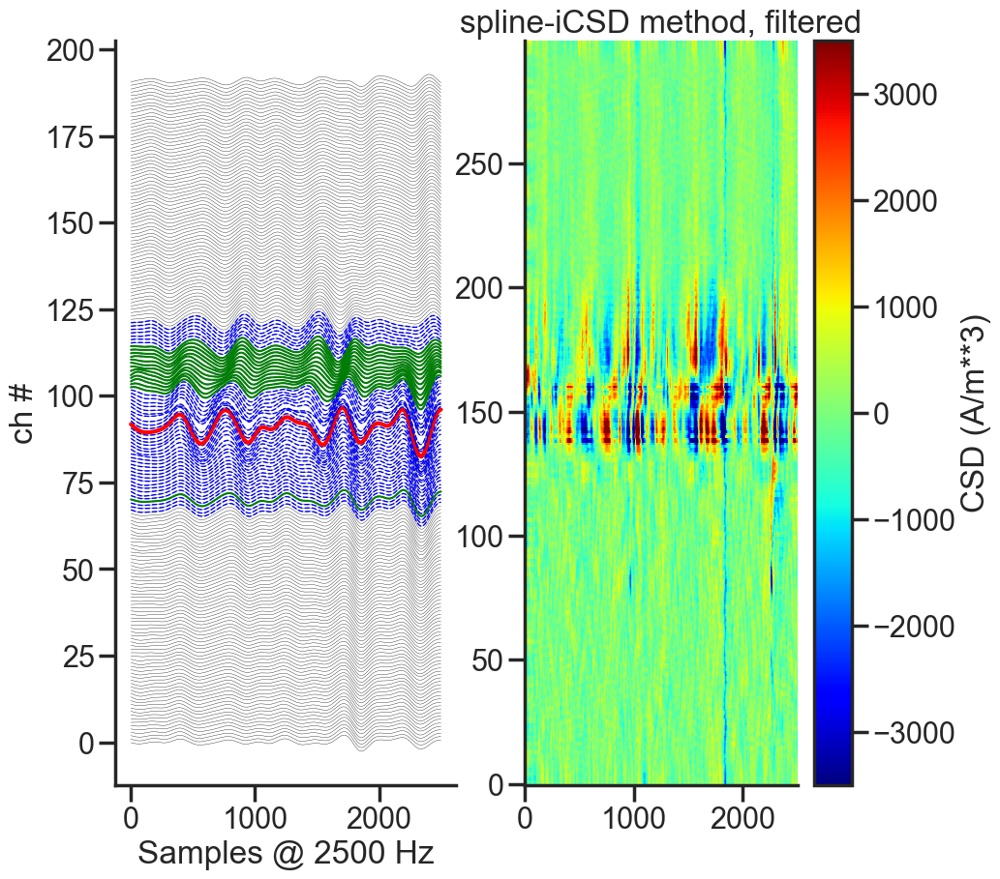

recid 35
(5000, 192)
theta channels [ 73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131]
93
192
192
(192, 5000)
fisure_candidates [ 0  0  1  2  3  4  9  9  9 10 18 25 28 28 33 34 39 47 47 47 52 52 55 63
 70 71 77 95]
absolute max min method [94 96]
absolute abs max method [94]
[ 73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131]
[ True False False False False False False False False False False False
 False False]
ripple ch [ 73 102 103 104 105 106 107 108 109 110 111 112 113 114 115]
[[0]]
96
discrete filter coefficients: 
b = [ 0.164 0.236 0.325 0.430 0.546 0.667 0.783 0.882 0.956 0.995 0.995 0.956 0.882 0.783 0.66

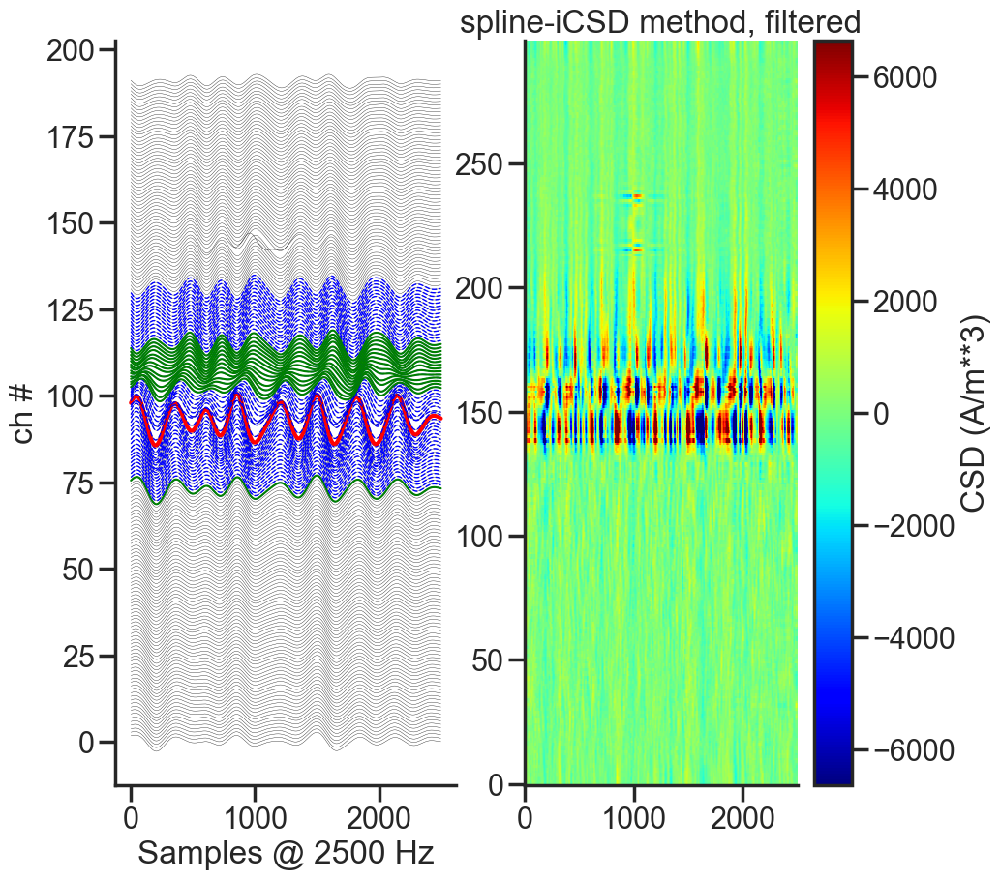

In [64]:
## Find CA1 and DG channels

df_ch = []

for idx in range(0,2):
    print('recid',ipath)
    
    data_lfp_tmp_mov = []
    data_lfp_tmp_mov = LfpB_mov[idx]*gain_correct[0]*1e6 ## in mV
    
    data_lfp_tmp_sta = []
    data_lfp_tmp_sta = LfpB_sta[idx]*gain_correct[0]*1e6 ## in mV    
    
    data_lfp_1 = np.mean([data_lfp_tmp_mov[:,:-1:2], data_lfp_tmp_mov[:,1:-1:2]],axis=0)
    data_lfp_2 = np.mean([data_lfp_tmp_sta[:,:-1:2], data_lfp_tmp_sta[:,1:-1:2]],axis=0)
    print(data_lfp_1.shape)

    ## plot raw lfp
    i1 = []
    i1 = HPC_lfp_CA1_DG_fisure_detection_v3(data_lfp_1, data_lfp_2, 1250, 40)
    
#     plt.savefig(r'C:\Users\fentonlab\Desktop\Local_copy_Ketamine_analysis\CA1_DG_id\\'
#                 + 'recid' + str(ipath) + '_CA1_DG_id.png', transparent = True)
    plt.show()
#     plt.clf()
#     plt.close() 
    
#     ksort_path = []
#     ksort_path = ksort_HPC_path_matched[ipath]

#     df_ch = pd.DataFrame({'rec_id':ipath , 'theta_start': i1[0], 'theta_end':i1[1] ,
#                                 'ripple_start':i1[2], 'ripple_end':i1[3]}, index = [0])

#     df_ch.head(2)
#     df_ch.to_excel(r'C:\Users\fentonlab\Desktop\Local_copy_Ketamine_analysis\CA1_DG_id\\'
#                 + 'recid' + str(ipath) + '_CA1_DG_id.xlsx')